In [14]:
import os
from typing import Optional, Tuple, List, Union, Callable

import numpy as np
import torch
from torch import nn
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d
from tqdm import trange

# For repeatability
# seed = 3407
# torch.manual_seed(seed)
# np.random.seed(seed)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [15]:
# Get the data (use terminal)
# if not os.path.exists('tiny_nerf_data.npz'):
#     !wget http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz

In [16]:
# FROM GAN_stability https://github.com/LMescheder/GAN_stability/blob/master/gan_training/config.py

import yaml
from torch import optim
from os import path

# General config
def load_config(path, default_path):
    ''' Loads config file.
    Args:  
        path (str): path to config file
        default_path (bool): whether to use default path
    '''
    # Load configuration from file itself
    with open(path, 'r') as f:
        # cfg_special = yaml.load(f)
        cfg_special = yaml.safe_load(f)

    # Check if we should inherit from a config
    inherit_from = cfg_special.get('inherit_from')

    # If yes, load this config first as default
    # If no, use the default_path
    if inherit_from is not None:
        cfg = load_config(inherit_from, default_path)
    elif default_path is not None:
        with open(default_path, 'r') as f:
            # cfg = yaml.load(f)
            cfg = yaml.safe_load(f)
    else:
        cfg = dict()

    # Include main configuration
    update_recursive(cfg, cfg_special)

    return cfg


def update_recursive(dict1, dict2):
    ''' Update two config dictionaries recursively.
    Args:
        dict1 (dict): first dictionary to be updated
        dict2 (dict): second dictionary which entries should be used
    '''
    for k, v in dict2.items():
        # Add item if not yet in dict1
        if k not in dict1:
            dict1[k] = None
        # Update
        if isinstance(dict1[k], dict):
            update_recursive(dict1[k], v)
        else:
            dict1[k] = v

In [17]:
import glob
import numpy as np
from PIL import Image

from torchvision.datasets.vision import VisionDataset


class ImageDataset(VisionDataset):
    """
    Load images from multiple data directories.
    Folder structure: data_dir/filename.png
    """

    def __init__(self, data_dirs, transforms=None):
#         print("****************************")
#         print("INIT")
#         print("****************************")
        # Use multiple root folders
        if not isinstance(data_dirs, list):
            data_dirs = [data_dirs]

        # initialize base class
        VisionDataset.__init__(self, root=data_dirs, transform=transforms)

        self.filenames = []
        root = []
        # print(self.root)
        for ddir in self.root:
            filenames = self._get_files(ddir)
            self.filenames.extend(filenames)
            root.append(ddir)
#         print("FILENAMES")
        # print(self.filenames)
#         print("****************************")
        self.filenames.sort()

    def __len__(self):
        return len(self.filenames)

    @staticmethod
    def _get_files(root_dir):
        return glob.glob(f'{root_dir}/*.png') + glob.glob(f'{root_dir}/*.jpg')

    def __getitem__(self, idx):
#         print("************************")
#         print("GET_ITEM")
        filename = self.filenames[idx]
        # print(self.filenames)
        img = Image.open(filename).convert('RGB')
        if self.transform is not None:
            img = self.transform(img)
#         print("************************")
        return img


class DRR(ImageDataset):
    def __init__(self, *args, **kwargs):
        super(DRR, self).__init__(*args, **kwargs)


class Carla(ImageDataset):
    def __init__(self, *args, **kwargs):
        super(Carla, self).__init__(*args, **kwargs)


class CelebA(ImageDataset):
    def __init__(self, *args, **kwargs):
        super(CelebA, self).__init__(*args, **kwargs)


class CUB(ImageDataset):
    def __init__(self, *args, **kwargs):
        super(CUB, self).__init__(*args, **kwargs)
        

class Cats(ImageDataset):
    def __init__(self, *args, **kwargs):
      super(Cats, self).__init__(*args, **kwargs)
    
    @staticmethod
    def _get_files(root_dir):
      return glob.glob(f'{root_dir}/CAT_*/*.jpg')


class CelebAHQ(ImageDataset):
    def __init__(self, *args, **kwargs):
        super(CelebAHQ, self).__init__(*args, **kwargs)
    
    def _get_files(self, root):
        return glob.glob(f'{root}/*.npy')
    
    def __getitem__(self, idx):
        img = np.load(self.filenames[idx]).squeeze(0).transpose(1,2,0)
        if img.dtype == np.uint8:
            pass
        elif img.dtype == np.float32:
            img = (img * 255).astype(np.uint8)
        else:
            raise NotImplementedError
        img = Image.fromarray(img).convert('RGB')
        if self.transform is not None:
            img = self.transform(img)
        
        return img

In [18]:
import numpy as np
import torch
import imageio
import os
import glob
from torch.utils import data
from torch.utils.data import Dataset
from PIL import Image


class  ImageFolder(Dataset):
    """docstring for ArtDataset"""
    def __init__(self, root, transform=None):
        super( ImageFolder, self).__init__()
        self.root = root

        self.frame = self._parse_frame()
        self.transform = transform

    def _parse_frame(self):
        frame = []
        folders = glob.glob(os.path.join(self.root, '*'))
        for folder in folders:
            for f in glob.glob(os.path.join(folder, '*.png')):
                frame.append(f)
        return frame

    def __len__(self):
        return len(self.frame)

    def __getitem__(self, idx):
        file = self.frame[idx]
        img = Image.open(file).convert('RGB')

        if self.transform:
            img = self.transform(img)

        return img

def InfiniteSampler(n):
    """Data sampler"""
    i = n - 1
    order = np.random.permutation(n)
    while True:
        yield order[i]
        i += 1
        if i >= n:
            np.random.seed()
            order = np.random.permutation(n)
            i = 0

class InfiniteSamplerWrapper(data.sampler.Sampler):
    """Data sampler wrapper"""
    def __init__(self, data_source):
        self.num_samples = len(data_source)

    def __iter__(self):
        return iter(InfiniteSampler(self.num_samples))

    def __len__(self):
        return 2 ** 15

def get_nsamples(data_loader, N):
  x = []
  n = 0
  while n < N:
    x_next = next(data_loader)
    x_next = x_next.cuda(non_blocking=True)
    x.append(x_next)
    n += x_next.size(0)
  x = torch.cat(x, dim=0)[:N]
  return x


def count_trainable_parameters(model):
  model_parameters = filter(lambda p: p.requires_grad, model.parameters())
  return sum([np.prod(p.size()) for p in model_parameters])


def save_video(imgs, fname, as_gif=False, fps=24, quality=8):
    # convert to np.uint8
    imgs = (255 * np.clip(imgs.permute(0, 2, 3, 1).detach().cpu().numpy() / 2 + 0.5, 0, 1)).astype(np.uint8)
    imageio.mimwrite(fname, imgs, fps=fps, quality=quality)
    
    if as_gif:  # save as gif, too
        os.system(f'ffmpeg -i {fname} -r 15 '
                  f'-vf "scale=512:-1,split[s0][s1];[s0]palettegen[p];[s1][p]paletteuse" {os.path.splitext(fname)[0] + ".gif"}')


def color_depth_map(depths, scale=None):
    """
    Color an input depth map.
    Arguments:
        depths -- HxW numpy array of depths
        [scale=None] -- scaling the values (defaults to the maximum depth)
    Returns:
        colored_depths -- HxWx3 numpy array visualizing the depths
    """

    _color_map_depths = np.array([
      [0, 0, 0],  # 0.000
      [0, 0, 255],  # 0.114
      [255, 0, 0],  # 0.299
      [255, 0, 255],  # 0.413
      [0, 255, 0],  # 0.587
      [0, 255, 255],  # 0.701
      [255, 255, 0],  # 0.886
      [255, 255, 255],  # 1.000
      [255, 255, 255],  # 1.000
    ]).astype(float)
    _color_map_bincenters = np.array([
      0.0,
      0.114,
      0.299,
      0.413,
      0.587,
      0.701,
      0.886,
      1.000,
      2.000,  # doesn't make a difference, just strictly higher than 1
    ])
  
    if scale is None:
      scale = depths.max()
  
    values = np.clip(depths.flatten() / scale, 0, 1)
    # for each value, figure out where they fit in in the bincenters: what is the last bincenter smaller than this value?
    lower_bin = ((values.reshape(-1, 1) >= _color_map_bincenters.reshape(1, -1)) * np.arange(0, 9)).max(axis=1)
    lower_bin_value = _color_map_bincenters[lower_bin]
    higher_bin_value = _color_map_bincenters[lower_bin + 1]
    alphas = (values - lower_bin_value) / (higher_bin_value - lower_bin_value)
    colors = _color_map_depths[lower_bin] * (1 - alphas).reshape(-1, 1) + _color_map_depths[
      lower_bin + 1] * alphas.reshape(-1, 1)
    return colors.reshape(depths.shape[0], depths.shape[1], 3).astype(np.uint8)


# Virtual camera utils


def to_sphere(u, v):
    theta = 2 * np.pi * u
    phi = np.arccos(1 - 2 * v)
    cx = np.sin(phi) * np.cos(theta)
    cy = np.sin(phi) * np.sin(theta)
    cz = np.cos(phi)
    s = np.stack([cx, cy, cz])
    return s


def polar_to_cartesian(r, theta, phi, deg=True):
    if deg:
        phi = phi * np.pi / 180
        theta = theta * np.pi / 180
    cx = np.sin(phi) * np.cos(theta)
    cy = np.sin(phi) * np.sin(theta)
    cz = np.cos(phi)
    return r * np.stack([cx, cy, cz])


def to_uv(loc):
    # normalize to unit sphere
    loc = loc / loc.norm(dim=1, keepdim=True)

    cx, cy, cz = loc.t()
    v = (1 - cz) / 2

    phi = torch.acos(cz)
    sin_phi = torch.sin(phi)

    # ensure we do not divide by zero
    eps = 1e-8
    sin_phi[sin_phi.abs() < eps] = eps

    theta = torch.acos(cx / sin_phi)

    # check for sign of phi
    cx_rec = sin_phi * torch.cos(theta)
    if not np.isclose(cx.numpy(), cx_rec.numpy(), atol=1e-5).all():
        sin_phi = -sin_phi

    # check for sign of theta
    cy_rec = sin_phi * torch.sin(theta)
    if not np.isclose(cy.numpy(), cy_rec.numpy(), atol=1e-5).all():
        theta = -theta

    u = theta / (2 * np.pi)
    assert np.isclose(to_sphere(u, v).detach().cpu().numpy(), loc.t().detach().cpu().numpy(), atol=1e-5).all()

    return u, v


def to_phi(u):
    return 360 * u  # 2*pi*u*180/pi


def to_theta(v):
    return np.arccos(1 - 2 * v) * 180. / np.pi


def sample_on_sphere(range_u=(0, 1), range_v=(0, 1)):
    u = np.random.uniform(*range_u)
    v = np.random.uniform(*range_v)
    return to_sphere(u, v)


def look_at(eye, at=np.array([0, 0, 0]), up=np.array([0, 0, 1]), eps=1e-5):
    at = at.astype(float).reshape(1, 3)
    up = up.astype(float).reshape(1, 3)

    eye = eye.reshape(-1, 3)
    up = up.repeat(eye.shape[0] // up.shape[0], axis=0)
    eps = np.array([eps]).reshape(1, 1).repeat(up.shape[0], axis=0)

    z_axis = eye - at
    z_axis /= np.max(np.stack([np.linalg.norm(z_axis, axis=1, keepdims=True), eps]))

    x_axis = np.cross(up, z_axis)
    x_axis /= np.max(np.stack([np.linalg.norm(x_axis, axis=1, keepdims=True), eps]))

    y_axis = np.cross(z_axis, x_axis)
    y_axis /= np.max(np.stack([np.linalg.norm(y_axis, axis=1, keepdims=True), eps]))

    r_mat = np.concatenate((x_axis.reshape(-1, 3, 1), y_axis.reshape(-1, 3, 1), z_axis.reshape(-1, 3, 1)), axis=2)

    return r_mat

In [19]:
import numpy as np
import torch
from torchvision.transforms import *

def save_config(outpath, config):
    from yaml import safe_dump
    with open(outpath, 'w') as f:
        safe_dump(config, f)


def update_config(config, unknown):
    # update config given args
    for idx,arg in enumerate(unknown):
        if arg.startswith("--"):
            if (':') in arg:
                k1,k2 = arg.replace("--","").split(':')
                argtype = type(config[k1][k2])
                if argtype == bool:
                    v = unknown[idx+1].lower() == 'true'
                else:
                    if config[k1][k2] is not None:
                        v = type(config[k1][k2])(unknown[idx+1])
                    else:
                        v = unknown[idx+1]
                print(f'Changing {k1}:{k2} ---- {config[k1][k2]} to {v}')
                config[k1][k2] = v
            else:
                k = arg.replace('--','')
                v = unknown[idx+1]
                argtype = type(config[k])
                print(f'Changing {k} ---- {config[k]} to {v}')
                config[k] = v

    return config


def get_data(config):
    H = W = imsize = config['data']['imsize']
    dset_type = config['data']['type']
    fov = config['data']['fov']

    transforms = Compose([
        Resize(imsize),
        ToTensor(),
        Lambda(lambda x: x * 2 - 1),
    ])

    kwargs = {
        'data_dirs': config['data']['datadir'],
        'transforms': transforms
    }

    if dset_type == 'carla':
        dset = Carla(**kwargs)

    elif dset_type == 'drr':
        dset = DRR(**kwargs)
        # print("DSET")
        # print(dset)

    elif dset_type == 'celebA':
        assert imsize <= 128, 'cropped GT data has lower resolution than imsize, consider using celebA_hq instead'
        transforms.transforms.insert(0, RandomHorizontalFlip())
        transforms.transforms.insert(0, CenterCrop(108))

        dset = CelebA(**kwargs)

    elif dset_type == 'celebA_hq':
        transforms.transforms.insert(0, RandomHorizontalFlip())
        transforms.transforms.insert(0, CenterCrop(650))

        dset = CelebAHQ(**kwargs)

    elif dset_type == 'cats':
      transforms.transforms.insert(0, RandomHorizontalFlip())
      dset = Cats(**kwargs)
  
    elif dset_type == 'cub':
        dset = CUB(**kwargs)

    dset.H = dset.W = imsize
    dset.focal = W/2 * 1 / np.tan((.5 * fov * np.pi/180.))
    radius = config['data']['radius']
    render_radius = radius
    if isinstance(radius, str):
        radius = tuple(float(r) for r in radius.split(','))
        render_radius = max(radius)
    dset.radius = radius

    # compute render poses
    N = 72
    num_volumes = 1
    theta = 0.5 * (to_theta(config['data']['vmin']) + to_theta(config['data']['vmax']))
    angle_range = (to_phi(config['data']['umin']), to_phi(config['data']['umax']))
    render_poses = get_render_poses(render_radius, num_volumes, angle_range=angle_range, theta=theta, N=N)

    print('Loaded {}'.format(dset_type), imsize, len(dset), render_poses.shape, [H,W,dset.focal,dset.radius], config['data']['datadir'])
    return dset, [H,W,dset.focal,dset.radius], render_poses


def get_render_poses(radius, num_volumes, angle_range=(0, 360), theta=0, N=40, swap_angles=False):
    poses = []
    theta = max(0.1, theta)
    for i in range(num_volumes):
        for angle in np.linspace(angle_range[0],angle_range[1],N+1)[:-1]:
            angle = max(0.1, angle)
            if swap_angles:
                loc = polar_to_cartesian(radius, theta, angle, deg=True)
            else:
                loc = polar_to_cartesian(radius, angle, theta, deg=True)
            R = look_at(loc)[0]
            RT = np.concatenate([R, loc.reshape(3, 1)], axis=1)
            # print(RT)
            # print(angle)
            newrow = [0, 0, 0, 1]
            RT = np.vstack([RT, newrow])
            poses.append(RT)
            # print(RT)
    return torch.from_numpy(np.stack(poses))

In [20]:
import os
from os import path

import sys

# Arguments
config = load_config("configs/chest.yaml", 'configs/default.yaml')
print(config['data'])

config['data']['fov'] = float(config['data']['fov'])
config = update_config(config, [])

out_dir = os.path.join(config['training']['outdir'], config['expname'])
checkpoint_dir = path.join(out_dir, 'chkpts')

# Create missing directories
if not path.exists(out_dir):
    os.makedirs(out_dir)
if not path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)

# Save config file
save_config(os.path.join(out_dir, 'config.yaml'), config)

# Dataset
train_dataset, hwfr, render_poses = get_data(config)
# in case of orthographic projection replace focal length by far-near
# print("FAR")
# print(config['data']['far'])
# print("NEAR")
# print(config['data']['near'])
# print(config['data']['orthographic'])
print("FOCAL??")
focal_test = hwfr[2]
print(hwfr[2])
if config['data']['orthographic']:
    print("ORTHOGRAPHIC")
    hw_ortho = (config['data']['far']-config['data']['near'], config['data']['far']-config['data']['near'])
    hwfr[2] = hw_ortho
    print(hwfr[2])
    # print("**********************************")

config['data']['hwfr'] = hwfr  # add for building generator

print()

print("TRAIN_DATASET:")
print("-------------------------------------------------")
print(train_dataset)

print(type(train_dataset))

print()

print("HWFR:")
print("-------------------------------------------------")
print(hwfr)

print()

print("RENDER_POSES.SHAPE:")
print("-------------------------------------------------")
print(render_poses.shape)
# print(render_poses[0])

# print(train_dataset, hwfr, render_poses.shape)

{'datadir': '/scratch/gpfs/agp3/IW2022/chest_xrays', 'type': 'drr', 'imsize': 128, 'white_bkgd': False, 'near': 7.5, 'far': 12.5, 'radius': '9.5,10.5', 'fov': 10.0, 'orthographic': False, 'augmentation': True, 'umin': 0, 'umax': 1.0, 'vmin': 0.32898992833716556, 'vmax': 0.45642212862617093}
Loaded drr 128 1440 torch.Size([72, 4, 4]) [128, 128, 731.523347376726, (9.5, 10.5)] /scratch/gpfs/agp3/IW2022/chest_xrays
FOCAL??
731.523347376726

TRAIN_DATASET:
-------------------------------------------------
Dataset DRR
    Number of datapoints: 1440
    Root location: ['/scratch/gpfs/agp3/IW2022/chest_xrays']
    StandardTransform
Transform: Compose(
               Resize(size=128, interpolation=bilinear, max_size=None, antialias=None)
               ToTensor()
               Lambda()
           )
<class '__main__.DRR'>

HWFR:
-------------------------------------------------
[128, 128, 731.523347376726, (9.5, 10.5)]

RENDER_POSES.SHAPE:
-------------------------------------------------
torch

In [21]:
images = []
for i in range(72):
    xray = train_dataset.__getitem__(i).transpose(2, 0).transpose(1, 0)
    xray = (xray + 1) / 2
    images.append(xray)
images = torch.from_numpy(np.stack(images))

In [22]:
print(images.shape)
print(render_poses.shape)

torch.Size([72, 128, 128, 3])
torch.Size([72, 4, 4])


Images shape: torch.Size([72, 128, 128, 3])
Poses shape: torch.Size([72, 4, 4])
Focal length: 731.523347376726
Pose
tensor([[ 0.0872, -0.2156,  0.9726, 10.2121],
        [ 0.9962,  0.0189, -0.0851, -0.8934],
        [-0.0000,  0.9763,  0.2164,  2.2726],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], dtype=torch.float64)


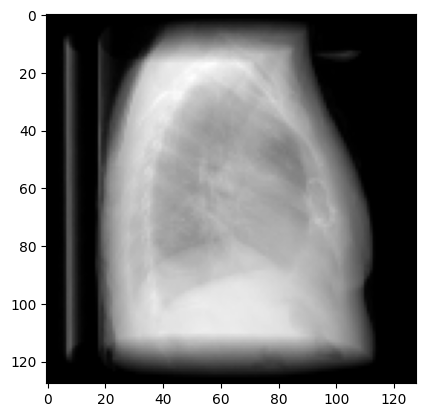

In [23]:
images = images
poses = render_poses
focal = focal_test # hwfr[2][0]

print(f'Images shape: {images.shape}')
print(f'Poses shape: {poses.shape}')
print(f'Focal length: {focal}')

height, width = hwfr[0], hwfr[1]
near, far = config['data']['near'], config['data']['far']

n_training = 71
testimg_idx = 71
testimg, testpose = images[testimg_idx], poses[testimg_idx]

plt.imshow(testimg)
print('Pose')
print(testpose)

In [24]:
images = images.numpy()
poses = poses.numpy()
focal = np.array(focal)

In [25]:
data = {}
data['images'] = images
data['poses'] = poses
data['focal'] = focal

In [26]:
def get_rays(
  height: int,
  width: int,
  focal_length: float,
  c2w: torch.Tensor
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Find origin and direction of rays through every pixel and camera origin.
  """

  # Apply pinhole camera model to gather directions at each pixel
  i, j = torch.meshgrid(
      torch.arange(width, dtype=torch.float32).to(c2w),
      torch.arange(height, dtype=torch.float32).to(c2w),
      indexing='ij')
  i, j = i.transpose(-1, -2), j.transpose(-1, -2)
  directions = torch.stack([(i - width * .5) / focal_length,
                            -(j - height * .5) / focal_length,
                            -torch.ones_like(i)
                           ], dim=-1)

  # Apply camera pose to directions
  rays_d = torch.sum(directions[..., None, :] * c2w[:3, :3], dim=-1)

  # Origin is same for all directions (the optical center)
  rays_o = c2w[:3, -1].expand(rays_d.shape)
  return rays_o, rays_d

In [27]:
torch.__version__

'1.13.0+cu116'

In [28]:
# Old version of torch

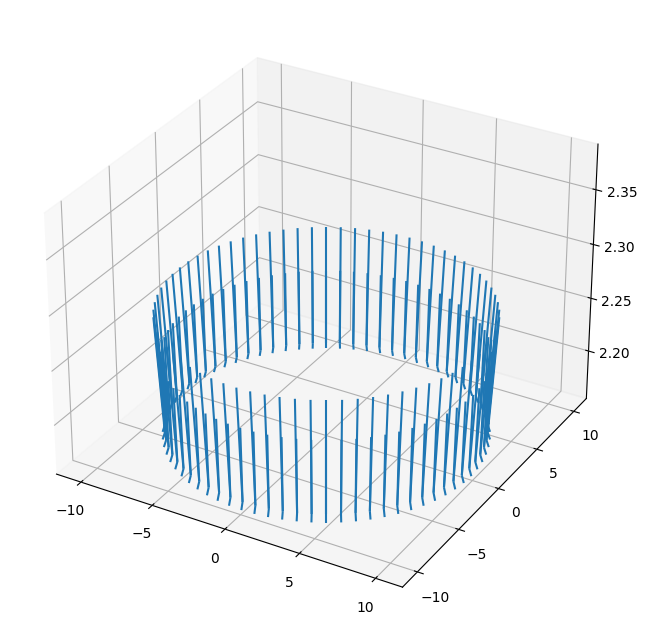

In [29]:
dirs = np.stack([np.sum([0, 0, -1] * pose[:3, :3], axis=-1) for pose in poses])
origins = poses[:, :3, -1]

ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
_ = ax.quiver(
  origins[..., 0].flatten(),
  origins[..., 1].flatten(),
  origins[..., 2].flatten(),
  dirs[..., 0].flatten(),
  dirs[..., 1].flatten(),
  dirs[..., 2].flatten(), length=0.5, normalize=True)
plt.show()

In [30]:
# Gather as torch tensors

# inputs = inputs.to(torch.float32)
images = torch.from_numpy(data['images'][:n_training]).to(torch.float32).to(device)
poses = torch.from_numpy(data['poses']).to(torch.float32).to(device)
focal = torch.from_numpy(data['focal']).to(torch.float32).to(device)
testimg = torch.from_numpy(data['images'][testimg_idx]).to(torch.float32).to(device)
testpose = torch.from_numpy(data['poses'][testimg_idx]).to(torch.float32).to(device)

# Grab rays from sample image
height, width = images.shape[1:3]
with torch.no_grad():
  ray_origin, ray_direction = get_rays(height, width, focal, testpose)

print('Ray Origin')
print(ray_origin.shape)
print(ray_origin[height // 2, width // 2, :])
print('')

print('Ray Direction')
print(ray_direction.shape)
print(ray_direction[height // 2, width // 2, :])
print('')

Ray Origin
torch.Size([128, 128, 3])
tensor([10.2121, -0.8934,  2.2726], device='cuda:0')

Ray Direction
torch.Size([128, 128, 3])
tensor([-0.9726,  0.0851, -0.2164], device='cuda:0')



In [31]:
def sample_stratified(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  n_samples: int,
  perturb: Optional[bool] = True,
  inverse_depth: bool = False
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Sample along ray from regularly-spaced bins.
  """

  # Grab samples for space integration along ray
  t_vals = torch.linspace(0., 1., n_samples, device=rays_o.device)
  if not inverse_depth:
    # Sample linearly between `near` and `far`
    z_vals = near * (1.-t_vals) + far * (t_vals)
  else:
    # Sample linearly in inverse depth (disparity)
    z_vals = 1./(1./near * (1.-t_vals) + 1./far * (t_vals))

  # Draw uniform samples from bins along ray
  if perturb:
    mids = .5 * (z_vals[1:] + z_vals[:-1])
    upper = torch.concat([mids, z_vals[-1:]], dim=-1)
    lower = torch.concat([z_vals[:1], mids], dim=-1)
    t_rand = torch.rand([n_samples], device=z_vals.device)
    z_vals = lower + (upper - lower) * t_rand
  z_vals = z_vals.expand(list(rays_o.shape[:-1]) + [n_samples])

  # Apply scale from `rays_d` and offset from `rays_o` to samples
  # pts: (width, height, n_samples, 3)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals[..., :, None]
  return pts, z_vals

In [32]:
# Draw stratified samples from example
rays_o = ray_origin.view([-1, 3])
rays_d = ray_direction.view([-1, 3])
n_samples = 8
perturb = True
inverse_depth = False
with torch.no_grad():
  pts, z_vals = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=perturb, inverse_depth=inverse_depth)

print('Input Points')
print(pts.shape)
print('')
print('Distances Along Ray')
print(z_vals.shape)

Input Points
torch.Size([16384, 8, 3])

Distances Along Ray
torch.Size([16384, 8])


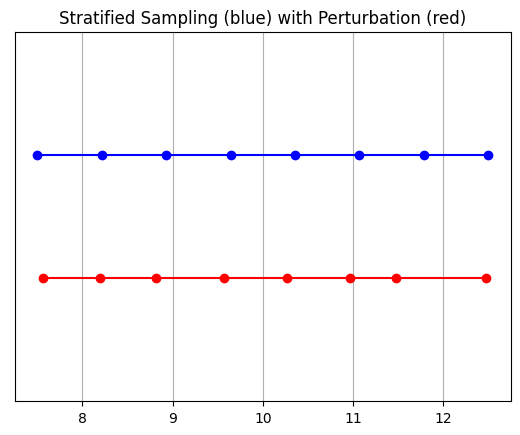

In [33]:
y_vals = torch.zeros_like(z_vals)

_, z_vals_unperturbed = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=False, inverse_depth=inverse_depth)
plt.plot(z_vals_unperturbed[0].cpu().numpy(), 1 + y_vals[0].cpu().numpy(), 'b-o')
plt.plot(z_vals[0].cpu().numpy(), y_vals[0].cpu().numpy(), 'r-o')
plt.ylim([-1, 2])
plt.title('Stratified Sampling (blue) with Perturbation (red)')
ax = plt.gca()
ax.axes.yaxis.set_visible(False)
plt.grid(True)

In [34]:
class PositionalEncoder(nn.Module):
  r"""
  Sine-cosine positional encoder for input points.
  """
  def __init__(
    self,
    d_input: int,
    n_freqs: int,
    log_space: bool = False
  ):
    super().__init__()
    self.d_input = d_input
    self.n_freqs = n_freqs
    self.log_space = log_space
    self.d_output = d_input * (1 + 2 * self.n_freqs)
    self.embed_fns = [lambda x: x]

    # Define frequencies in either linear or log scale
    if self.log_space:
      freq_bands = 2.**torch.linspace(0., self.n_freqs - 1, self.n_freqs)
    else:
      freq_bands = torch.linspace(2.**0., 2.**(self.n_freqs - 1), self.n_freqs)

    # Alternate sin and cos
    for freq in freq_bands:
      self.embed_fns.append(lambda x, freq=freq: torch.sin(x * freq))
      self.embed_fns.append(lambda x, freq=freq: torch.cos(x * freq))
  
  def forward(
    self,
    x
  ) -> torch.Tensor:
    r"""
    Apply positional encoding to input.
    """
    return torch.concat([fn(x) for fn in self.embed_fns], dim=-1)


In [35]:
# Create encoders for points and view directions
encoder = PositionalEncoder(3, 10)
viewdirs_encoder = PositionalEncoder(3, 4)

# Grab flattened points and view directions
pts_flattened = pts.reshape(-1, 3)
viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
flattened_viewdirs = viewdirs[:, None, ...].expand(pts.shape).reshape((-1, 3))

# Encode inputs
encoded_points = encoder(pts_flattened)
encoded_viewdirs = viewdirs_encoder(flattened_viewdirs)

print('Encoded Points')
print(encoded_points.shape)
print(torch.min(encoded_points), torch.max(encoded_points), torch.mean(encoded_points))
print('')

print(encoded_viewdirs.shape)
print('Encoded Viewdirs')
print(torch.min(encoded_viewdirs), torch.max(encoded_viewdirs), torch.mean(encoded_viewdirs))
print('')

Encoded Points
torch.Size([131072, 63])
tensor(-2.2517, device='cuda:0') tensor(3.0505, device='cuda:0') tensor(0.0422, device='cuda:0')

torch.Size([131072, 27])
Encoded Viewdirs
tensor(-1., device='cuda:0') tensor(1., device='cuda:0') tensor(0.0877, device='cuda:0')



In [36]:
class NeRF(nn.Module):
  r"""
  Neural radiance fields module.
  """
  def __init__(
    self,
    d_input: int = 3,
    n_layers: int = 8,
    d_filter: int = 256,
    skip: Tuple[int] = (4,),
    d_viewdirs: Optional[int] = None
  ):
    super().__init__()
    self.d_input = d_input
    self.skip = skip
    self.act = nn.functional.relu
    self.d_viewdirs = d_viewdirs

    # Create model layers
    self.layers = nn.ModuleList(
      [nn.Linear(self.d_input, d_filter)] +
      [nn.Linear(d_filter + self.d_input, d_filter) if i in skip \
       else nn.Linear(d_filter, d_filter) for i in range(n_layers - 1)]
    )

    # Bottleneck layers
    if self.d_viewdirs is not None:
      # If using viewdirs, split alpha and RGB
      self.alpha_out = nn.Linear(d_filter, 1)
      self.rgb_filters = nn.Linear(d_filter, d_filter)
      self.branch = nn.Linear(d_filter + self.d_viewdirs, d_filter // 2)
      self.output = nn.Linear(d_filter // 2, 3)
    else:
      # If no viewdirs, use simpler output
      self.output = nn.Linear(d_filter, 4)
  
  def forward(
    self,
    x: torch.Tensor,
    viewdirs: Optional[torch.Tensor] = None
  ) -> torch.Tensor:
    r"""
    Forward pass with optional view direction.
    """

    # Cannot use viewdirs if instantiated with d_viewdirs = None
    if self.d_viewdirs is None and viewdirs is not None:
      raise ValueError('Cannot input x_direction if d_viewdirs was not given.')

    # Apply forward pass up to bottleneck
    x_input = x
    for i, layer in enumerate(self.layers):
      x = self.act(layer(x))
      if i in self.skip:
        x = torch.cat([x, x_input], dim=-1)

    # Apply bottleneck
    if self.d_viewdirs is not None:
      # Split alpha from network output
      alpha = self.alpha_out(x)

      # Pass through bottleneck to get RGB
      x = self.rgb_filters(x)
      x = torch.concat([x, viewdirs], dim=-1)
      x = self.act(self.branch(x))
      x = self.output(x)

      # Concatenate alphas to output
      x = torch.concat([x, alpha], dim=-1)
    else:
      # Simple output
      x = self.output(x)
    return x

In [37]:
def cumprod_exclusive(
  tensor: torch.Tensor
) -> torch.Tensor:
  r"""
  (Courtesy of https://github.com/krrish94/nerf-pytorch)

  Mimick functionality of tf.math.cumprod(..., exclusive=True), as it isn't available in PyTorch.

  Args:
  tensor (torch.Tensor): Tensor whose cumprod (cumulative product, see `torch.cumprod`) along dim=-1
    is to be computed.
  Returns:
  cumprod (torch.Tensor): cumprod of Tensor along dim=-1, mimiciking the functionality of
    tf.math.cumprod(..., exclusive=True) (see `tf.math.cumprod` for details).
  """

  # Compute regular cumprod first (this is equivalent to `tf.math.cumprod(..., exclusive=False)`).
  cumprod = torch.cumprod(tensor, -1)
  # "Roll" the elements along dimension 'dim' by 1 element.
  cumprod = torch.roll(cumprod, 1, -1)
  # Replace the first element by "1" as this is what tf.cumprod(..., exclusive=True) does.
  cumprod[..., 0] = 1.
  
  return cumprod

def raw2outputs(
  raw: torch.Tensor,
  z_vals: torch.Tensor,
  rays_d: torch.Tensor,
  raw_noise_std: float = 0.0,
  white_bkgd: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Convert the raw NeRF output into RGB and other maps.
  """

  # Difference between consecutive elements of `z_vals`. [n_rays, n_samples]
  dists = z_vals[..., 1:] - z_vals[..., :-1]
  dists = torch.cat([dists, 1e10 * torch.ones_like(dists[..., :1])], dim=-1)

  # Multiply each distance by the norm of its corresponding direction ray
  # to convert to real world distance (accounts for non-unit directions).
  dists = dists * torch.norm(rays_d[..., None, :], dim=-1)

  # Add noise to model's predictions for density. Can be used to 
  # regularize network during training (prevents floater artifacts).
  noise = 0.
  if raw_noise_std > 0.:
    noise = torch.randn(raw[..., 3].shape) * raw_noise_std

  # Predict density of each sample along each ray. Higher values imply
  # higher likelihood of being absorbed at this point. [n_rays, n_samples]
  alpha = 1.0 - torch.exp(-nn.functional.relu(raw[..., 3] + noise) * dists)

  # Compute weight for RGB of each sample along each ray. [n_rays, n_samples]
  # The higher the alpha, the lower subsequent weights are driven.
  weights = alpha * cumprod_exclusive(1. - alpha + 1e-10)

  # Compute weighted RGB map.
  rgb = torch.sigmoid(raw[..., :3])  # [n_rays, n_samples, 3]
  rgb_map = torch.sum(weights[..., None] * rgb, dim=-2)  # [n_rays, 3]

  # Estimated depth map is predicted distance.
  depth_map = torch.sum(weights * z_vals, dim=-1)

  # Disparity map is inverse depth.
  disp_map = 1. / torch.max(1e-10 * torch.ones_like(depth_map),
                            depth_map / torch.sum(weights, -1))

  # Sum of weights along each ray. In [0, 1] up to numerical error.
  acc_map = torch.sum(weights, dim=-1)

  # To composite onto a white background, use the accumulated alpha map.
  if white_bkgd:
    rgb_map = rgb_map + (1. - acc_map[..., None])

  return rgb_map, depth_map, acc_map, weights

In [38]:
def sample_pdf(
  bins: torch.Tensor,
  weights: torch.Tensor,
  n_samples: int,
  perturb: bool = False
) -> torch.Tensor:
  r"""
  Apply inverse transform sampling to a weighted set of points.
  """

  # Normalize weights to get PDF.
  pdf = (weights + 1e-5) / torch.sum(weights + 1e-5, -1, keepdims=True) # [n_rays, weights.shape[-1]]

  # Convert PDF to CDF.
  cdf = torch.cumsum(pdf, dim=-1) # [n_rays, weights.shape[-1]]
  cdf = torch.concat([torch.zeros_like(cdf[..., :1]), cdf], dim=-1) # [n_rays, weights.shape[-1] + 1]

  # Take sample positions to grab from CDF. Linear when perturb == 0.
  if not perturb:
    u = torch.linspace(0., 1., n_samples, device=cdf.device)
    u = u.expand(list(cdf.shape[:-1]) + [n_samples]) # [n_rays, n_samples]
  else:
    u = torch.rand(list(cdf.shape[:-1]) + [n_samples], device=cdf.device) # [n_rays, n_samples]

  # Find indices along CDF where values in u would be placed.
  u = u.contiguous() # Returns contiguous tensor with same values.
  inds = torch.searchsorted(cdf, u, right=True) # [n_rays, n_samples]

  # Clamp indices that are out of bounds.
  below = torch.clamp(inds - 1, min=0)
  above = torch.clamp(inds, max=cdf.shape[-1] - 1)
  inds_g = torch.stack([below, above], dim=-1) # [n_rays, n_samples, 2]

  # Sample from cdf and the corresponding bin centers.
  matched_shape = list(inds_g.shape[:-1]) + [cdf.shape[-1]]
  cdf_g = torch.gather(cdf.unsqueeze(-2).expand(matched_shape), dim=-1,
                       index=inds_g)
  bins_g = torch.gather(bins.unsqueeze(-2).expand(matched_shape), dim=-1,
                        index=inds_g)

  # Convert samples to ray length.
  denom = (cdf_g[..., 1] - cdf_g[..., 0])
  denom = torch.where(denom < 1e-5, torch.ones_like(denom), denom)
  t = (u - cdf_g[..., 0]) / denom
  samples = bins_g[..., 0] + t * (bins_g[..., 1] - bins_g[..., 0])

  return samples # [n_rays, n_samples]

In [39]:
def sample_hierarchical(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  z_vals: torch.Tensor,
  weights: torch.Tensor,
  n_samples: int,
  perturb: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Apply hierarchical sampling to the rays.
  """

  # Draw samples from PDF using z_vals as bins and weights as probabilities.
  z_vals_mid = .5 * (z_vals[..., 1:] + z_vals[..., :-1])
  new_z_samples = sample_pdf(z_vals_mid, weights[..., 1:-1], n_samples,
                          perturb=perturb)
  new_z_samples = new_z_samples.detach()

  # Resample points from ray based on PDF.
  z_vals_combined, _ = torch.sort(torch.cat([z_vals, new_z_samples], dim=-1), dim=-1)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals_combined[..., :, None]  # [N_rays, N_samples + n_samples, 3]
  return pts, z_vals_combined, new_z_samples

In [40]:
def get_chunks(
  inputs: torch.Tensor,
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Divide an input into chunks.
  """
  return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

def prepare_chunks(
  points: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify points to prepare for NeRF model.
  """
  points = points.reshape((-1, 3))
  points = encoding_function(points)
  points = get_chunks(points, chunksize=chunksize)
  return points

def prepare_viewdirs_chunks(
  points: torch.Tensor,
  rays_d: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify viewdirs to prepare for NeRF model.
  """
  # Prepare the viewdirs
  viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
  viewdirs = viewdirs[:, None, ...].expand(points.shape).reshape((-1, 3))
  viewdirs = encoding_function(viewdirs)
  viewdirs = get_chunks(viewdirs, chunksize=chunksize)
  return viewdirs

In [41]:
def nerf_forward(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  encoding_fn: Callable[[torch.Tensor], torch.Tensor],
  coarse_model: nn.Module,
  kwargs_sample_stratified: dict = None,
  n_samples_hierarchical: int = 0,
  kwargs_sample_hierarchical: dict = None,
  fine_model = None,
  viewdirs_encoding_fn: Optional[Callable[[torch.Tensor], torch.Tensor]] = None,
  chunksize: int = 2**15
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, dict]:
  r"""
  Compute forward pass through model(s).
  """

  # Set no kwargs if none are given.
  if kwargs_sample_stratified is None:
    kwargs_sample_stratified = {}
  if kwargs_sample_hierarchical is None:
    kwargs_sample_hierarchical = {}
  
  # Sample query points along each ray.
  query_points, z_vals = sample_stratified(
      rays_o, rays_d, near, far, **kwargs_sample_stratified)

  # Prepare batches.
  batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
  if viewdirs_encoding_fn is not None:
    batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                               viewdirs_encoding_fn,
                                               chunksize=chunksize)
  else:
    batches_viewdirs = [None] * len(batches)

  # Coarse model pass.
  # Split the encoded points into "chunks", run the model on all chunks, and
  # concatenate the results (to avoid out-of-memory issues).
  predictions = []
  for batch, batch_viewdirs in zip(batches, batches_viewdirs):
    predictions.append(coarse_model(batch, viewdirs=batch_viewdirs))
  raw = torch.cat(predictions, dim=0)
  raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

  # Perform differentiable volume rendering to re-synthesize the RGB image.
  rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals, rays_d)
  # rgb_map, depth_map, acc_map, weights = render_volume_density(raw, rays_o, z_vals)
  outputs = {
      'z_vals_stratified': z_vals
  }

  # Fine model pass.
  if n_samples_hierarchical > 0:
    # Save previous outputs to return.
    rgb_map_0, depth_map_0, acc_map_0 = rgb_map, depth_map, acc_map

    # Apply hierarchical sampling for fine query points.
    query_points, z_vals_combined, z_hierarch = sample_hierarchical(
      rays_o, rays_d, z_vals, weights, n_samples_hierarchical,
      **kwargs_sample_hierarchical)

    # Prepare inputs as before.
    batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
    if viewdirs_encoding_fn is not None:
      batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                                 viewdirs_encoding_fn,
                                                 chunksize=chunksize)
    else:
      batches_viewdirs = [None] * len(batches)

    # Forward pass new samples through fine model.
    fine_model = fine_model if fine_model is not None else coarse_model
    predictions = []
    for batch, batch_viewdirs in zip(batches, batches_viewdirs):
      predictions.append(fine_model(batch, viewdirs=batch_viewdirs))
    raw = torch.cat(predictions, dim=0)
    raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

    # Perform differentiable volume rendering to re-synthesize the RGB image.
    rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals_combined, rays_d)
    
    # Store outputs.
    outputs['z_vals_hierarchical'] = z_hierarch
    outputs['rgb_map_0'] = rgb_map_0
    outputs['depth_map_0'] = depth_map_0
    outputs['acc_map_0'] = acc_map_0

  # Store outputs.
  outputs['rgb_map'] = rgb_map
  outputs['depth_map'] = depth_map
  outputs['acc_map'] = acc_map
  outputs['weights'] = weights
  return outputs

In [42]:
# Encoders
d_input = 3           # Number of input dimensions
n_freqs = 10          # Number of encoding functions for samples
log_space = True      # If set, frequencies scale in log space
use_viewdirs = True   # If set, use view direction as input
n_freqs_views = 4     # Number of encoding functions for views

# Stratified sampling
n_samples = 64         # Number of spatial samples per ray
perturb = True         # If set, applies noise to sample positions
inverse_depth = False  # If set, samples points linearly in inverse depth

# Model
d_filter = 128          # Dimensions of linear layer filters
n_layers = 2            # Number of layers in network bottleneck
skip = []               # Layers at which to apply input residual
use_fine_model = True   # If set, creates a fine model
d_filter_fine = 128     # Dimensions of linear layer filters of fine network
n_layers_fine = 6       # Number of layers in fine network bottleneck

# Hierarchical sampling
n_samples_hierarchical = 64   # Number of samples per ray
perturb_hierarchical = False  # If set, applies noise to sample positions

# Optimizer
lr = 5e-4  # Learning rate

# Training
n_iters = 10000
batch_size = 2**14          # Number of rays per gradient step (power of 2)
one_image_per_step = True   # One image per gradient step (disables batching)
chunksize = 2**14           # Modify as needed to fit in GPU memory
center_crop = True          # Crop the center of image (one_image_per_)
center_crop_iters = 50      # Stop cropping center after this many epochs
display_rate = 25          # Display test output every X epochs

# Early Stopping
warmup_iters = 100          # Number of iterations during warmup phase
warmup_min_fitness = 10.0   # Min val PSNR to continue training at warmup_iters
n_restarts = 10             # Number of times to restart if training stalls

# We bundle the kwargs for various functions to pass all at once.
kwargs_sample_stratified = {
    'n_samples': n_samples,
    'perturb': perturb,
    'inverse_depth': inverse_depth
}
kwargs_sample_hierarchical = {
    'perturb': perturb
}

In [43]:
def plot_samples(
  z_vals: torch.Tensor,
  z_hierarch: Optional[torch.Tensor] = None,
  ax: Optional[np.ndarray] = None):
  r"""
  Plot stratified and (optional) hierarchical samples.
  """
  y_vals = 1 + np.zeros_like(z_vals)

  if ax is None:
    ax = plt.subplot()
  ax.plot(z_vals, y_vals, 'b-o')
  if z_hierarch is not None:
    y_hierarch = np.zeros_like(z_hierarch)
    ax.plot(z_hierarch, y_hierarch, 'r-o')
  ax.set_ylim([-1, 2])
  ax.set_title('Stratified  Samples (blue) and Hierarchical Samples (red)')
  ax.axes.yaxis.set_visible(False)
  ax.grid(True)
  return ax

def crop_center(
  img: torch.Tensor,
  frac: float = 0.5
) -> torch.Tensor:
  r"""
  Crop center square from image.
  """
  h_offset = round(img.shape[0] * (frac / 2))
  w_offset = round(img.shape[1] * (frac / 2))
  return img[h_offset:-h_offset, w_offset:-w_offset]

class EarlyStopping:
  r"""
  Early stopping helper based on fitness criterion.
  """
  def __init__(
    self,
    patience: int = 30,
    margin: float = 1e-4
  ):
    self.best_fitness = 0.0  # In our case PSNR
    self.best_iter = 0
    self.margin = margin
    self.patience = patience or float('inf')  # epochs to wait after fitness stops improving to stop

  def __call__(
    self,
    iter: int,
    fitness: float
  ):
    r"""
    Check if criterion for stopping is met.
    """
    if (fitness - self.best_fitness) > self.margin:
      self.best_iter = iter
      self.best_fitness = fitness
    delta = iter - self.best_iter
    stop = delta >= self.patience  # stop training if patience exceeded
    return stop

In [44]:
def init_models():
  r"""
  Initialize models, encoders, and optimizer for NeRF training.
  """
  # Encoders
  encoder = PositionalEncoder(d_input, n_freqs, log_space=log_space)
  encode = lambda x: encoder(x)

  # View direction encoders
  if use_viewdirs:
    encoder_viewdirs = PositionalEncoder(d_input, n_freqs_views,
                                        log_space=log_space)
    encode_viewdirs = lambda x: encoder_viewdirs(x)
    d_viewdirs = encoder_viewdirs.d_output
  else:
    encode_viewdirs = None
    d_viewdirs = None

  # Models
  model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
              d_viewdirs=d_viewdirs)
  model.to(device)
  model_params = list(model.parameters())
  if use_fine_model:
    fine_model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
                      d_viewdirs=d_viewdirs)
    fine_model.to(device)
    model_params = model_params + list(fine_model.parameters())
  else:
    fine_model = None

  # Optimizer
  optimizer = torch.optim.Adam(model_params, lr=lr)

  # Early Stopping
  warmup_stopper = EarlyStopping(patience=50)

  return model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper

In [49]:
def train():
  r"""
  Launch training session for NeRF.
  """
  # Shuffle rays across all images.
  if not one_image_per_step:
    height, width = images.shape[1:3]
    all_rays = torch.stack([torch.stack(get_rays(height, width, focal, p), 0)
                        for p in poses[:n_training]], 0)
    rays_rgb = torch.cat([all_rays, images[:, None]], 1)
    rays_rgb = torch.permute(rays_rgb, [0, 2, 3, 1, 4])
    rays_rgb = rays_rgb.reshape([-1, 3, 3])
    rays_rgb = rays_rgb.type(torch.float32)
    rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
    i_batch = 0

  train_psnrs = []
  val_psnrs = []
  iternums = []
  for i in trange(n_iters):
    model.train()

    if one_image_per_step:
      # Randomly pick an image as the target.
      target_img_idx = np.random.randint(images.shape[0])
      target_img = images[target_img_idx].to(device)
      if center_crop and i < center_crop_iters:
        target_img = crop_center(target_img)
      height, width = target_img.shape[:2]
      target_pose = poses[target_img_idx].to(device)
      rays_o, rays_d = get_rays(height, width, focal, target_pose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
    else:
      # Random over all images.
      batch = rays_rgb[i_batch:i_batch + batch_size]
      batch = torch.transpose(batch, 0, 1)
      rays_o, rays_d, target_img = batch
      height, width = target_img.shape[:2]
      i_batch += batch_size
      # Shuffle after one epoch
      if i_batch >= rays_rgb.shape[0]:
          rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
          i_batch = 0
    target_img = target_img.reshape([-1, 3])

    # Run one iteration of TinyNeRF and get the rendered RGB image.
    outputs = nerf_forward(rays_o, rays_d,
                           near, far, encode, model,
                           kwargs_sample_stratified=kwargs_sample_stratified,
                           n_samples_hierarchical=n_samples_hierarchical,
                           kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                           fine_model=fine_model,
                           viewdirs_encoding_fn=encode_viewdirs,
                           chunksize=chunksize)
    
    # Check for any numerical issues.
    for k, v in outputs.items():
      if torch.isnan(v).any():
        print(f"! [Numerical Alert] {k} contains NaN.")
      if torch.isinf(v).any():
        print(f"! [Numerical Alert] {k} contains Inf.")

    # Backprop!
    rgb_predicted = outputs['rgb_map']
    loss = torch.nn.functional.mse_loss(rgb_predicted, target_img)
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()

    # Compute mean-squared error between predicted and target images.
    psnr = -10. * torch.log10(loss)
    train_psnrs.append(psnr.item())

    # Evaluate testimg at given display rate.
    if i % display_rate == 0:
      model.eval()
      height, width = testimg.shape[:2]
      rays_o, rays_d = get_rays(height, width, focal, testpose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
      outputs = nerf_forward(rays_o, rays_d,
                             near, far, encode, model,
                             kwargs_sample_stratified=kwargs_sample_stratified,
                             n_samples_hierarchical=n_samples_hierarchical,
                             kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                             fine_model=fine_model,
                             viewdirs_encoding_fn=encode_viewdirs,
                             chunksize=chunksize)

      rgb_predicted = outputs['rgb_map']
      loss = torch.nn.functional.mse_loss(rgb_predicted, testimg.reshape(-1, 3))
      print("Loss:", loss.item())
      val_psnr = -10. * torch.log10(loss)
      
      val_psnrs.append(val_psnr.item())
      iternums.append(i)
      
        
      print(rays_o, rays_d)
      # Plot example outputs
      fig, ax = plt.subplots(1, 4, figsize=(24,4), gridspec_kw={'width_ratios': [1, 1, 1, 3]})
      ax[0].imshow(rgb_predicted.reshape([height, width, 3]).detach().cpu().numpy())
      ax[0].set_title(f'Iteration: {i}')
      ax[1].imshow(testimg.detach().cpu().numpy())
      ax[1].set_title(f'Target')
      ax[2].plot(range(0, i + 1), train_psnrs, 'r')
      ax[2].plot(iternums, val_psnrs, 'b')
      ax[2].set_title('PSNR (train=red, val=blue')
      z_vals_strat = outputs['z_vals_stratified'].view((-1, n_samples))
      z_sample_strat = z_vals_strat[z_vals_strat.shape[0] // 2].detach().cpu().numpy()
      if 'z_vals_hierarchical' in outputs:
        z_vals_hierarch = outputs['z_vals_hierarchical'].view((-1, n_samples_hierarchical))
        z_sample_hierarch = z_vals_hierarch[z_vals_hierarch.shape[0] // 2].detach().cpu().numpy()
      else:
        z_sample_hierarch = None
      _ = plot_samples(z_sample_strat, z_sample_hierarch, ax=ax[3])
      ax[3].margins(0)
      plt.show()

    # Check PSNR for issues and stop if any are found.
#     if i == warmup_iters - 1:
#       if val_psnr < warmup_min_fitness:
#         print(f'Val PSNR {val_psnr} below warmup_min_fitness {warmup_min_fitness}. Stopping...')
#         return False, train_psnrs, val_psnrs
#     elif i < warmup_iters:
#       if warmup_stopper is not None and warmup_stopper(i, psnr):
#         print(f'Train PSNR flatlined at {psnr} for {warmup_stopper.patience} iters. Stopping...')
#         return False, train_psnrs, val_psnrs
    
  return True, train_psnrs, val_psnrs

  0%|          | 0/10000 [00:00<?, ?it/s]

Loss: 0.19971869885921478
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


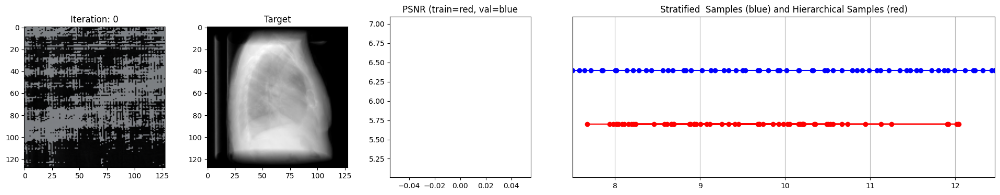

  0%|          | 25/10000 [00:03<20:25,  8.14it/s] 

Loss: 0.17387935519218445
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


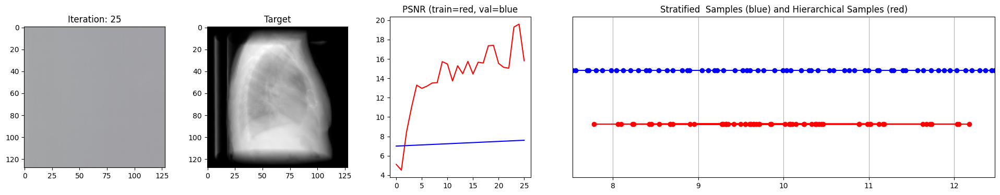

  0%|          | 50/10000 [00:07<20:18,  8.17it/s]

Loss: 0.19184094667434692
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


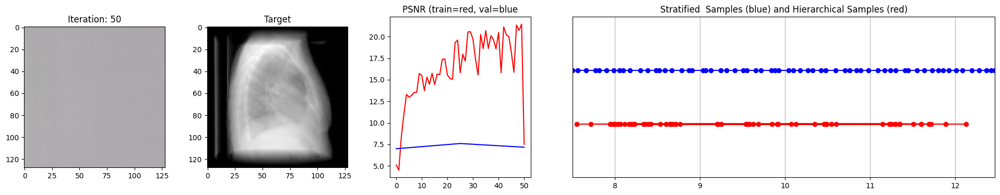

  1%|          | 75/10000 [00:16<56:30,  2.93it/s]  

Loss: 0.129305899143219
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


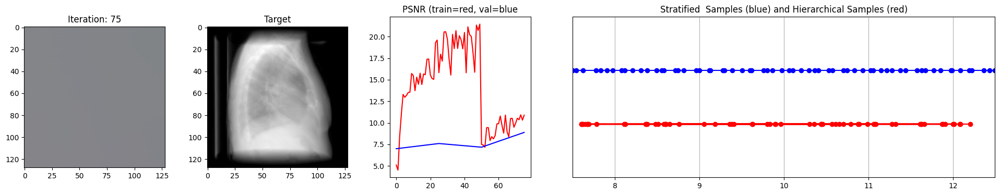

  1%|          | 100/10000 [00:25<59:44,  2.76it/s] 

Loss: 0.11825868487358093
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


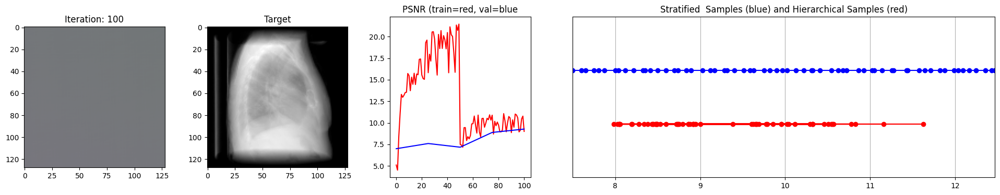

  1%|▏         | 125/10000 [00:35<56:20,  2.92it/s]  

Loss: 0.11248642206192017
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


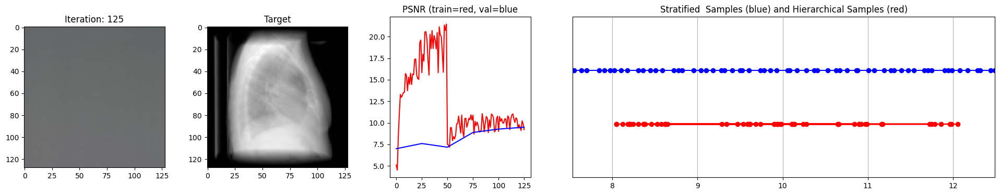

  2%|▏         | 150/10000 [00:44<52:49,  3.11it/s]  

Loss: 0.10911190509796143
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


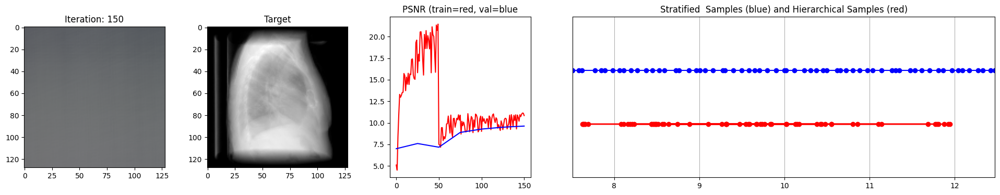

  2%|▏         | 175/10000 [00:53<51:40,  3.17it/s]  

Loss: 0.10276370495557785
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


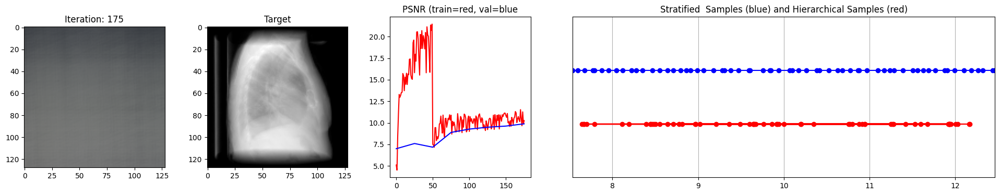

  2%|▏         | 200/10000 [01:03<46:55,  3.48it/s]  

Loss: 0.0896737203001976
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


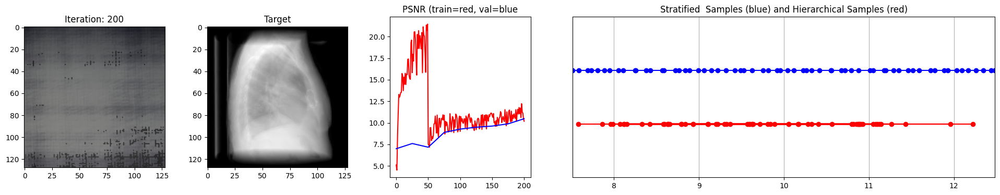

  2%|▏         | 225/10000 [01:12<49:24,  3.30it/s]  

Loss: 0.08367269486188889
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


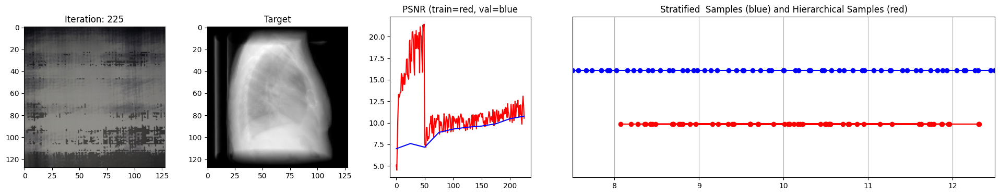

  2%|▎         | 250/10000 [01:21<46:39,  3.48it/s]  

Loss: 0.06657209247350693
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


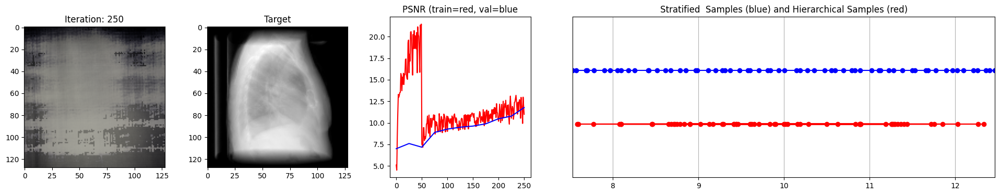

  3%|▎         | 275/10000 [01:30<44:01,  3.68it/s]  

Loss: 0.049012742936611176
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


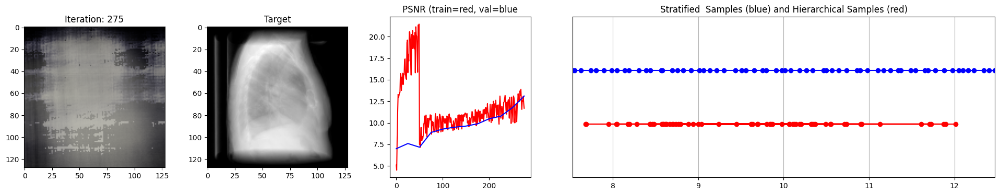

  3%|▎         | 300/10000 [01:40<43:34,  3.71it/s]  

Loss: 0.03091805800795555
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


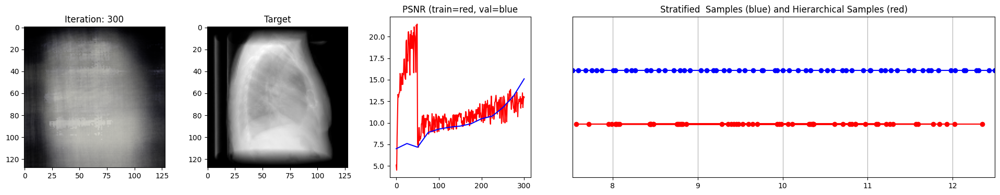

  3%|▎         | 325/10000 [01:49<46:15,  3.49it/s]  

Loss: 0.02288264036178589
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


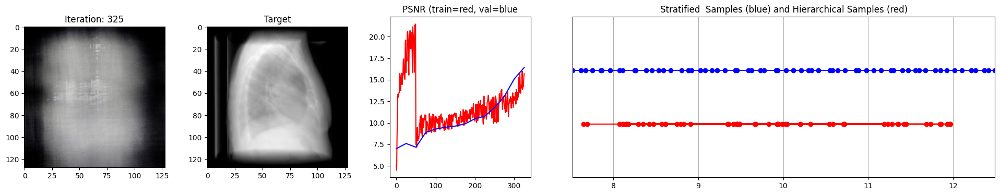

  4%|▎         | 350/10000 [01:58<45:39,  3.52it/s]  

Loss: 0.020084593445062637
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


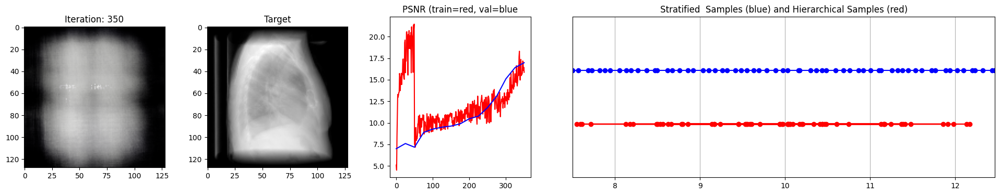

  4%|▍         | 375/10000 [02:08<46:14,  3.47it/s]  

Loss: 0.015654977411031723
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


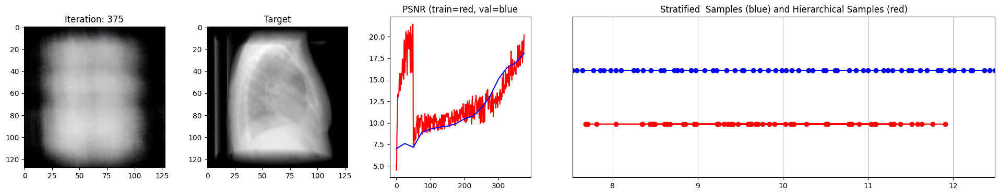

  4%|▍         | 400/10000 [02:17<48:21,  3.31it/s]  

Loss: 0.013530428521335125
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


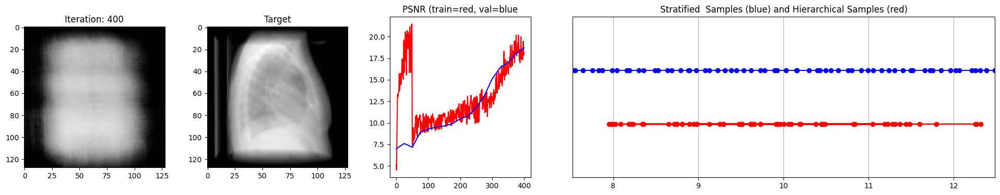

  4%|▍         | 425/10000 [02:26<44:48,  3.56it/s]  

Loss: 0.012938736006617546
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


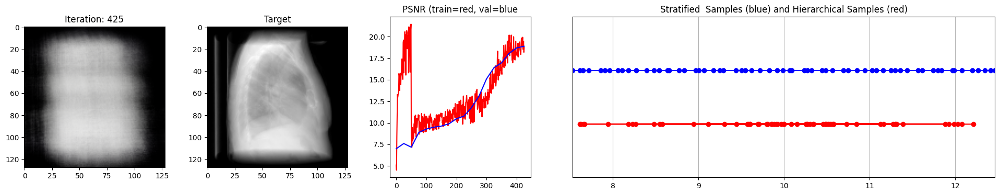

  4%|▍         | 450/10000 [02:35<48:05,  3.31it/s]  

Loss: 0.012682462111115456
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


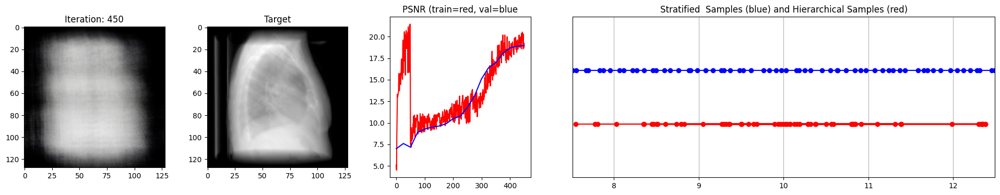

  5%|▍         | 475/10000 [02:45<48:51,  3.25it/s]  

Loss: 0.012062400579452515
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


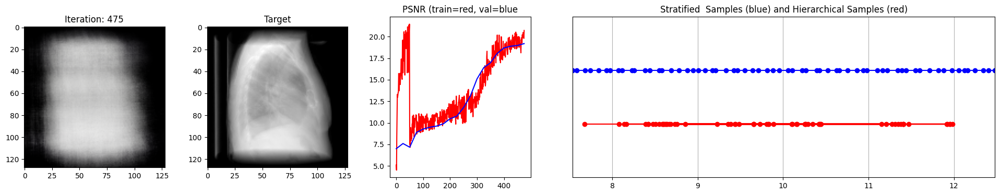

  5%|▌         | 500/10000 [02:54<49:30,  3.20it/s]  

Loss: 0.011248629540205002
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


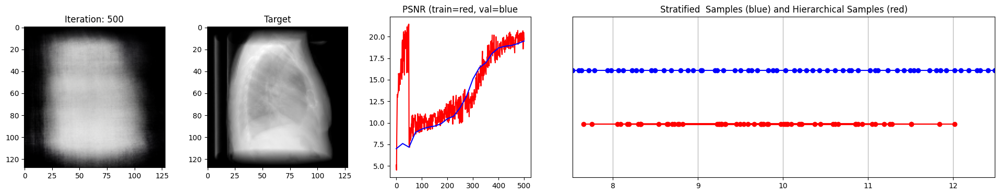

  5%|▌         | 525/10000 [03:03<46:51,  3.37it/s]  

Loss: 0.010204456746578217
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


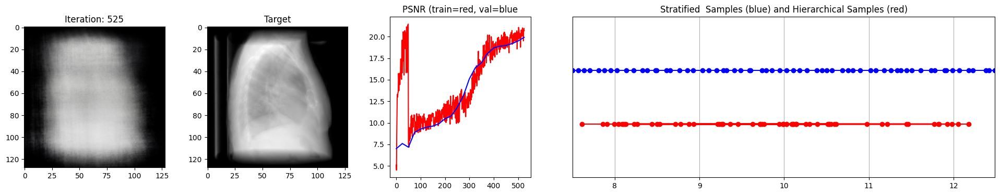

  6%|▌         | 550/10000 [03:13<49:44,  3.17it/s]  

Loss: 0.01041011419147253
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


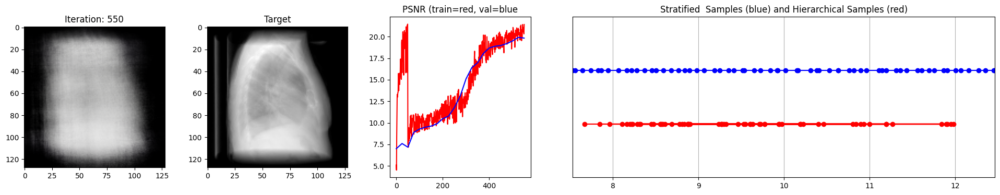

  6%|▌         | 575/10000 [03:22<49:46,  3.16it/s]  

Loss: 0.008889805525541306
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


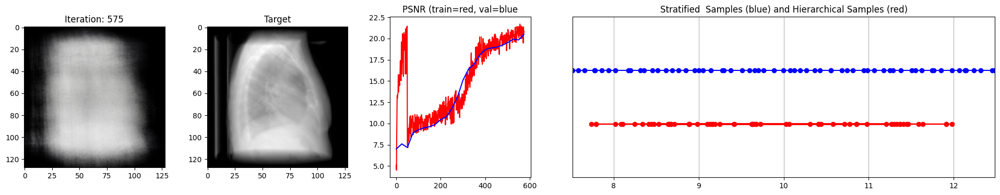

  6%|▌         | 600/10000 [03:31<50:00,  3.13it/s]  

Loss: 0.008578114211559296
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


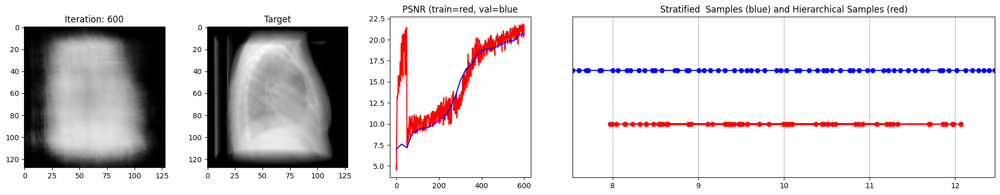

  6%|▋         | 625/10000 [03:41<52:03,  3.00it/s]  

Loss: 0.009483950212597847
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


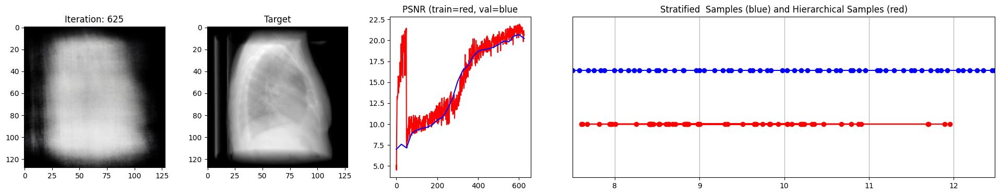

  6%|▋         | 650/10000 [03:50<51:22,  3.03it/s]  

Loss: 0.008180507458746433
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


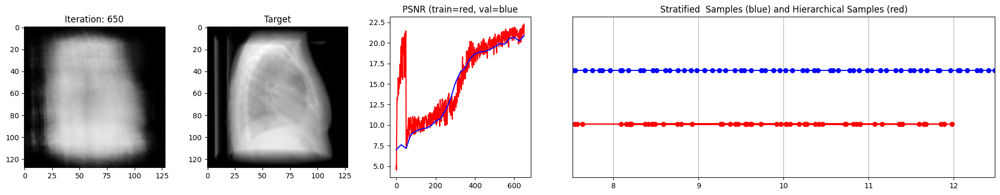

  7%|▋         | 675/10000 [03:59<51:10,  3.04it/s]  

Loss: 0.008631529286503792
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


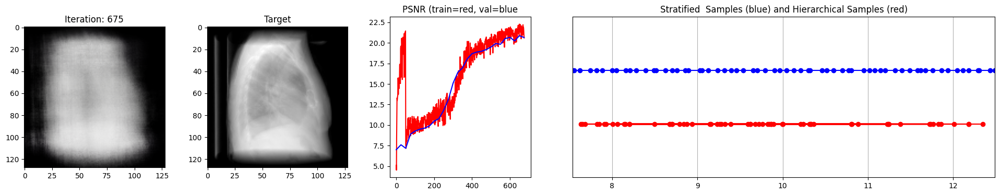

  7%|▋         | 700/10000 [04:09<52:20,  2.96it/s]  

Loss: 0.008273241110146046
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


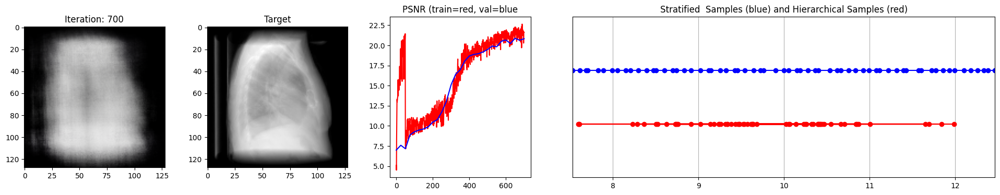

  7%|▋         | 725/10000 [04:18<53:15,  2.90it/s]  

Loss: 0.007733967155218124
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


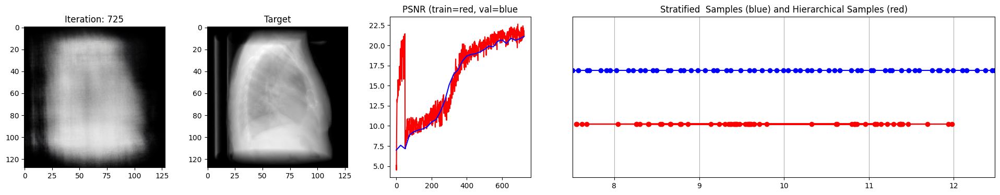

  8%|▊         | 750/10000 [04:27<52:00,  2.96it/s]  

Loss: 0.007501530926674604
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


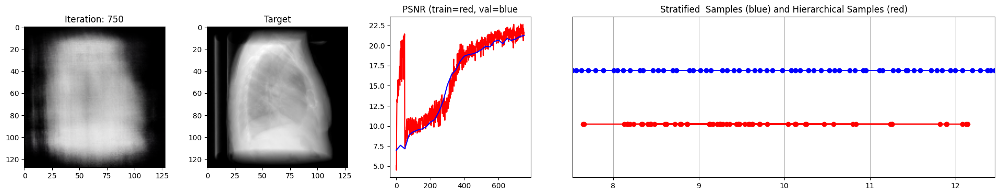

  8%|▊         | 775/10000 [04:36<53:14,  2.89it/s]  

Loss: 0.007022704929113388
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


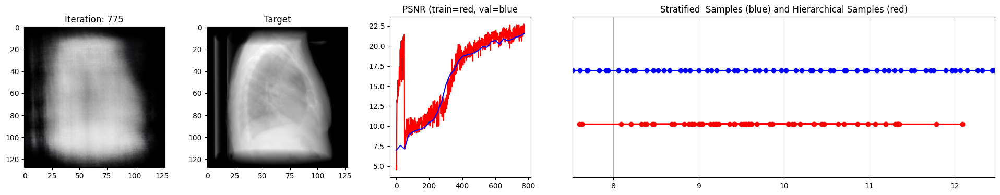

  8%|▊         | 800/10000 [04:46<53:57,  2.84it/s]  

Loss: 0.007505233399569988
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


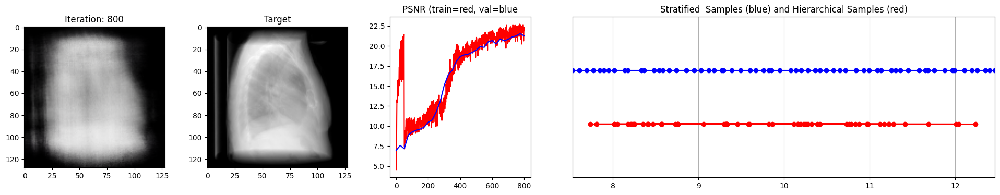

  8%|▊         | 825/10000 [04:55<53:22,  2.86it/s]  

Loss: 0.007243399973958731
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


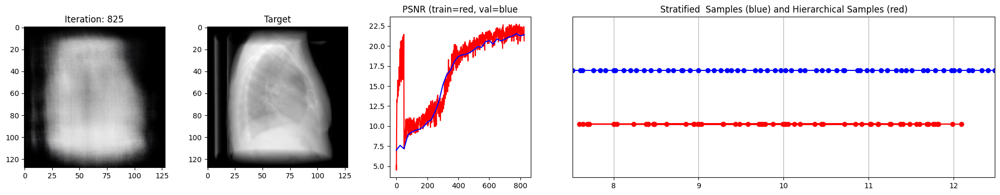

  8%|▊         | 850/10000 [05:04<53:35,  2.85it/s]  

Loss: 0.006852883845567703
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


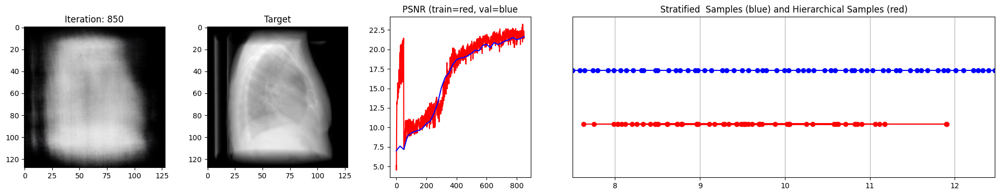

  9%|▉         | 875/10000 [05:14<54:19,  2.80it/s]  

Loss: 0.006681661121547222
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


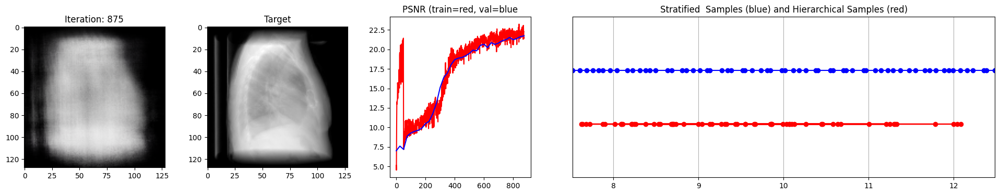

  9%|▉         | 900/10000 [05:23<54:04,  2.80it/s]  

Loss: 0.007697809487581253
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


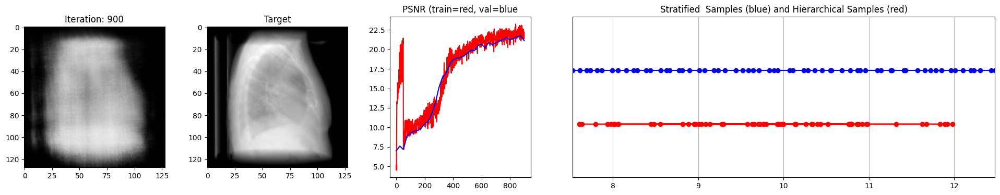

  9%|▉         | 925/10000 [05:32<54:24,  2.78it/s]  

Loss: 0.007056630216538906
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


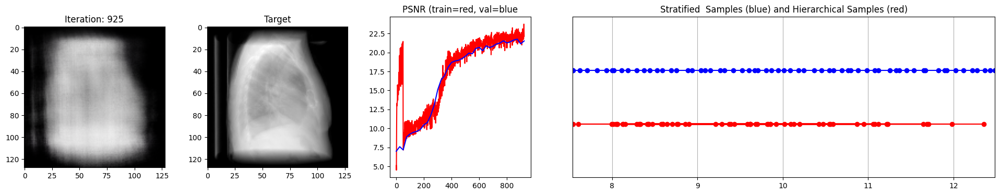

 10%|▉         | 950/10000 [05:42<53:45,  2.81it/s]  

Loss: 0.00735541433095932
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


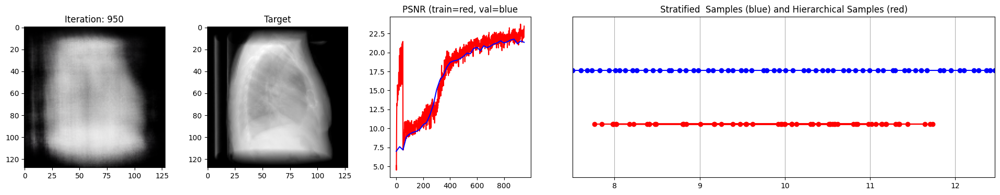

 10%|▉         | 975/10000 [05:51<53:00,  2.84it/s]  

Loss: 0.007338114082813263
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


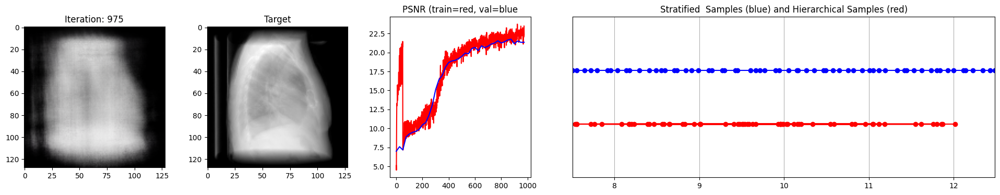

 10%|█         | 1000/10000 [06:00<53:50,  2.79it/s] 

Loss: 0.007033277302980423
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


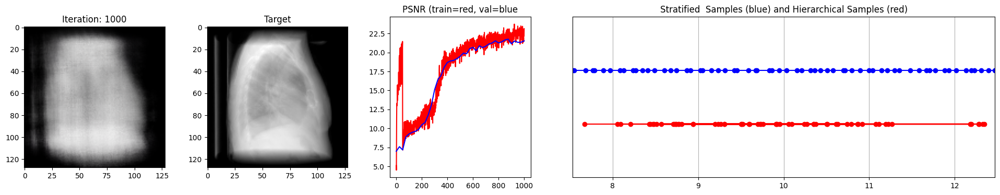

 10%|█         | 1025/10000 [06:10<54:10,  2.76it/s]  

Loss: 0.006789845414459705
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


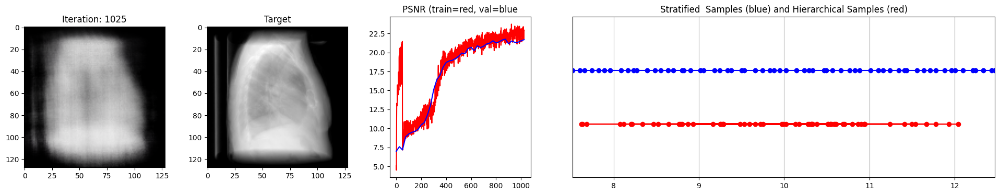

 10%|█         | 1050/10000 [06:19<53:50,  2.77it/s]  

Loss: 0.0066685243509709835
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


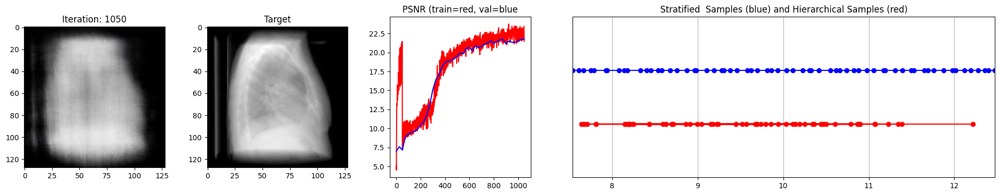

 11%|█         | 1075/10000 [06:28<53:10,  2.80it/s]  

Loss: 0.006461927201598883
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


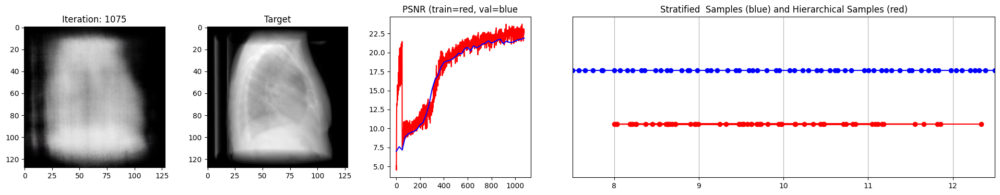

 11%|█         | 1100/10000 [06:38<53:27,  2.77it/s]  

Loss: 0.006390801630914211
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


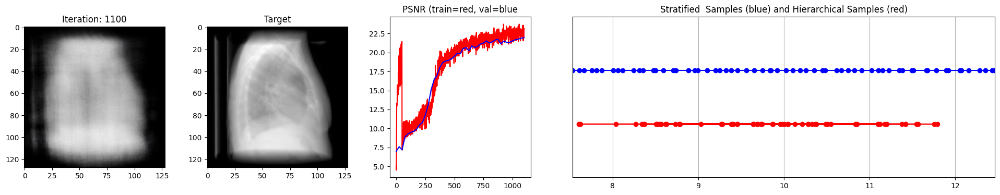

 11%|█▏        | 1125/10000 [06:47<53:13,  2.78it/s]  

Loss: 0.00608777953311801
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


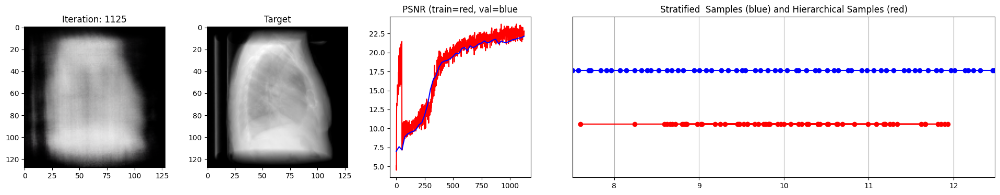

 12%|█▏        | 1150/10000 [06:56<53:30,  2.76it/s]  

Loss: 0.006185438483953476
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


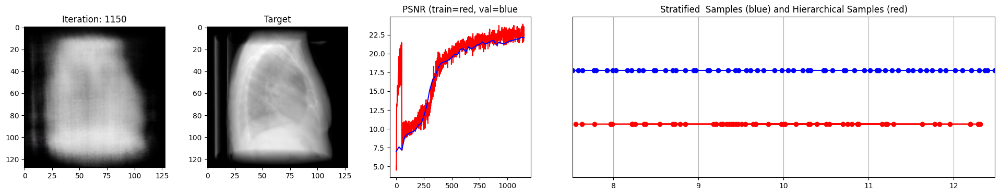

 12%|█▏        | 1175/10000 [07:06<53:22,  2.76it/s]  

Loss: 0.006335585378110409
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


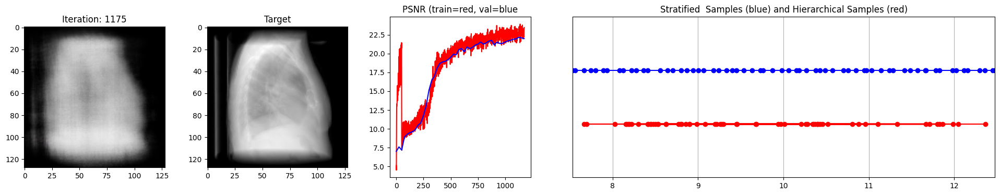

 12%|█▏        | 1200/10000 [07:15<51:48,  2.83it/s]  

Loss: 0.006453990936279297
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


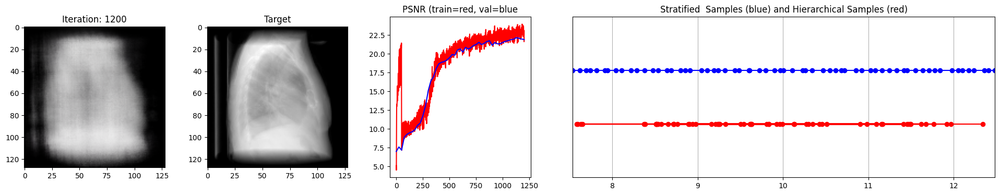

 12%|█▏        | 1225/10000 [07:24<52:50,  2.77it/s]  

Loss: 0.006684601306915283
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


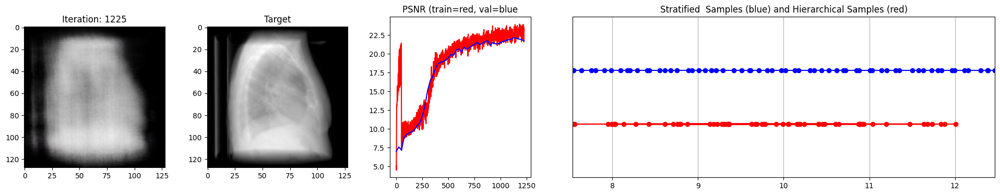

 12%|█▎        | 1250/10000 [07:33<52:36,  2.77it/s]  

Loss: 0.006239383481442928
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


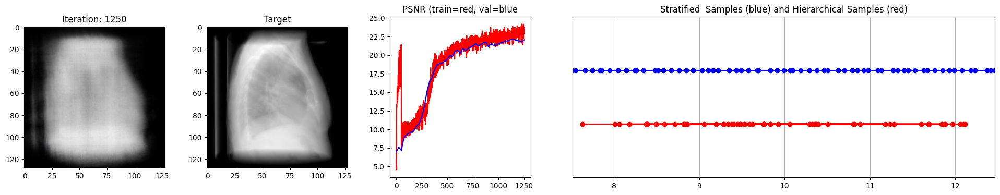

 13%|█▎        | 1275/10000 [07:43<52:57,  2.75it/s]  

Loss: 0.006371036171913147
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


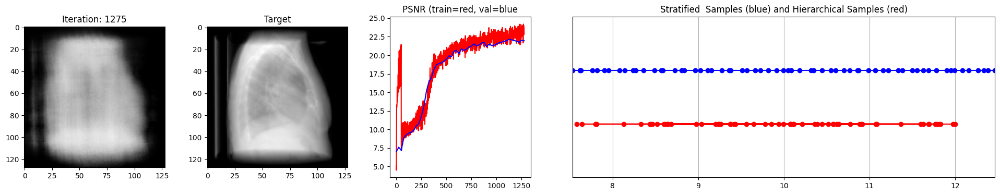

 13%|█▎        | 1300/10000 [07:52<52:48,  2.75it/s]  

Loss: 0.006530641578137875
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


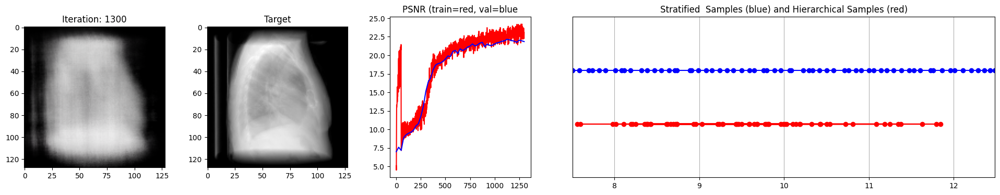

 13%|█▎        | 1325/10000 [08:01<52:16,  2.77it/s]  

Loss: 0.006226050667464733
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


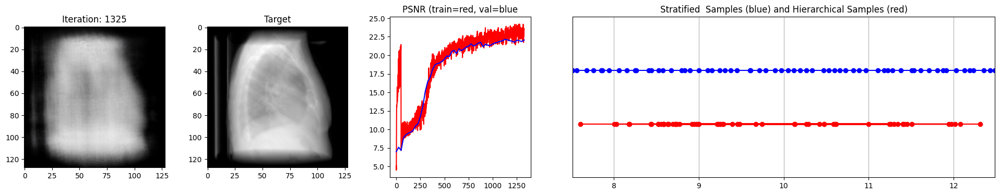

 14%|█▎        | 1350/10000 [08:11<52:27,  2.75it/s]  

Loss: 0.0060186367481946945
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


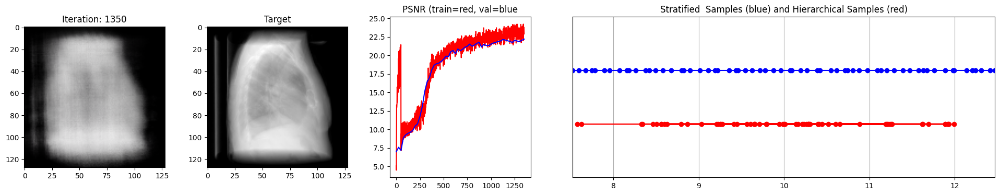

 14%|█▍        | 1375/10000 [08:20<52:14,  2.75it/s]  

Loss: 0.006077562924474478
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


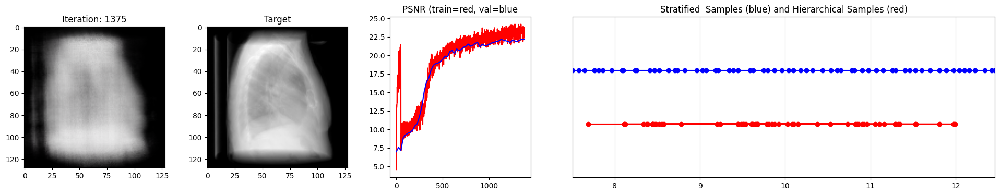

 14%|█▍        | 1400/10000 [08:29<52:08,  2.75it/s]  

Loss: 0.005225887056440115
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


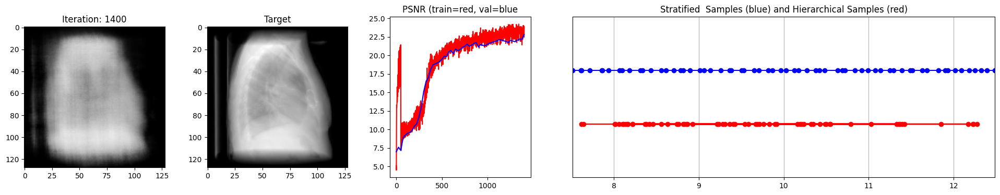

 14%|█▍        | 1425/10000 [08:38<52:01,  2.75it/s]  

Loss: 0.0053552379831671715
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


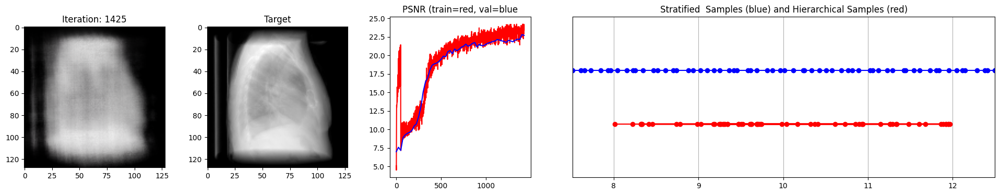

 14%|█▍        | 1450/10000 [08:48<51:58,  2.74it/s]  

Loss: 0.00528843654319644
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


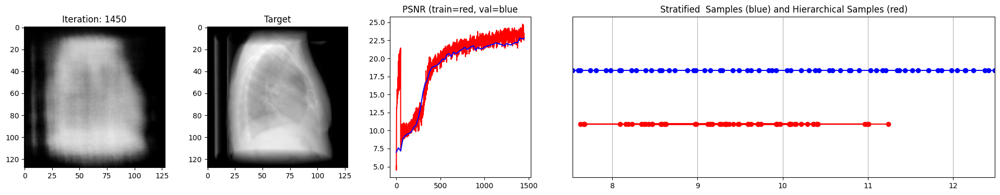

 15%|█▍        | 1475/10000 [08:57<51:37,  2.75it/s]  

Loss: 0.005233669187873602
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


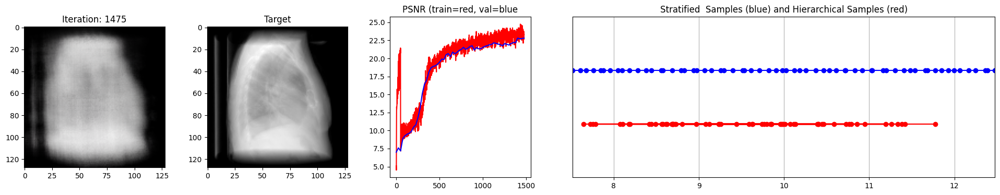

 15%|█▌        | 1500/10000 [09:06<51:37,  2.74it/s]  

Loss: 0.005324645899236202
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


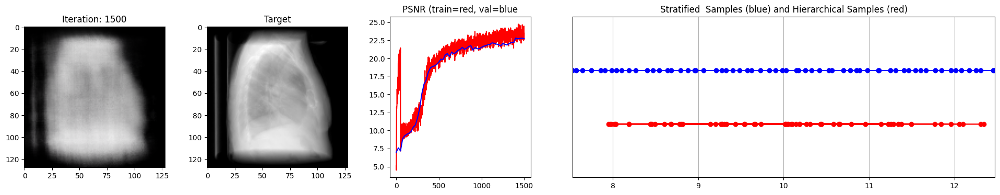

 15%|█▌        | 1525/10000 [09:16<51:20,  2.75it/s]  

Loss: 0.004782330244779587
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


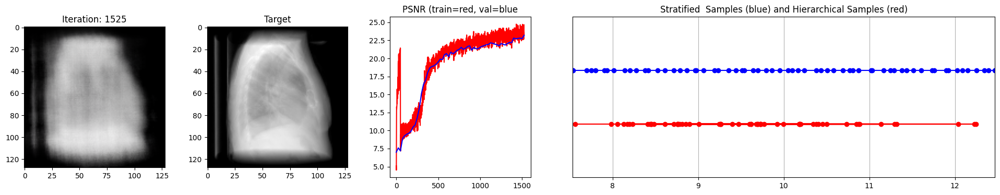

 16%|█▌        | 1550/10000 [09:25<51:17,  2.75it/s]  

Loss: 0.005636946763843298
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


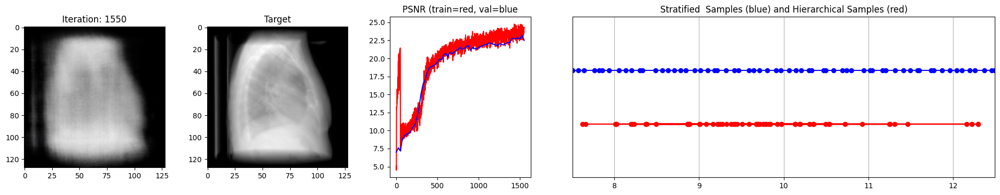

 16%|█▌        | 1575/10000 [09:34<51:22,  2.73it/s]  

Loss: 0.005369245074689388
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


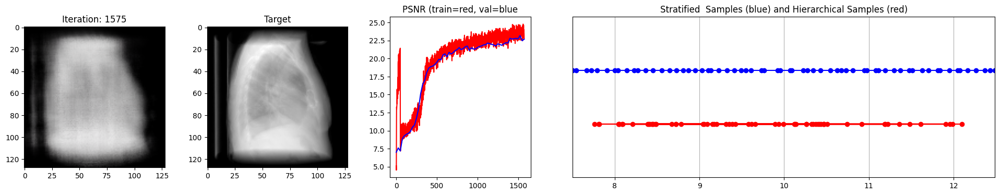

 16%|█▌        | 1600/10000 [09:44<51:01,  2.74it/s]  

Loss: 0.004935000091791153
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


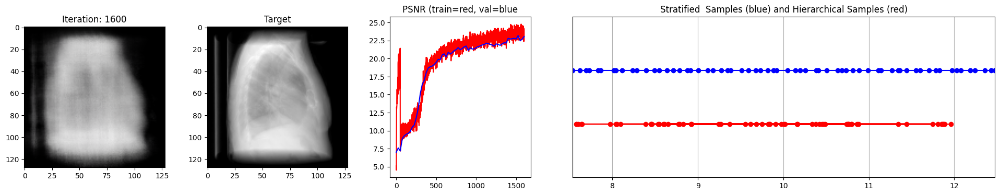

 16%|█▋        | 1625/10000 [09:53<50:46,  2.75it/s]  

Loss: 0.004736676346510649
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


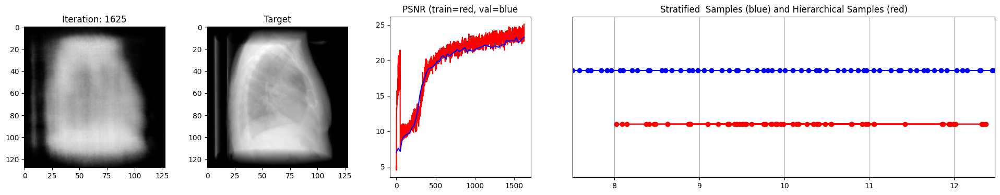

 16%|█▋        | 1650/10000 [10:02<50:45,  2.74it/s]  

Loss: 0.006265886127948761
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


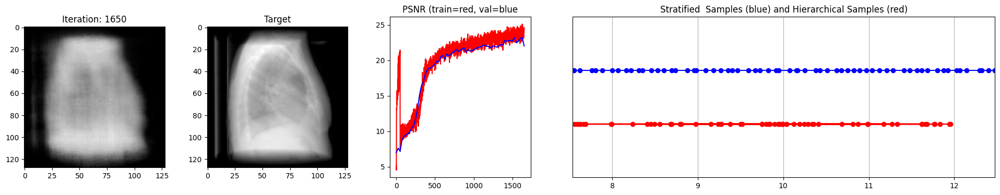

 17%|█▋        | 1675/10000 [10:11<50:59,  2.72it/s]  

Loss: 0.004911310970783234
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


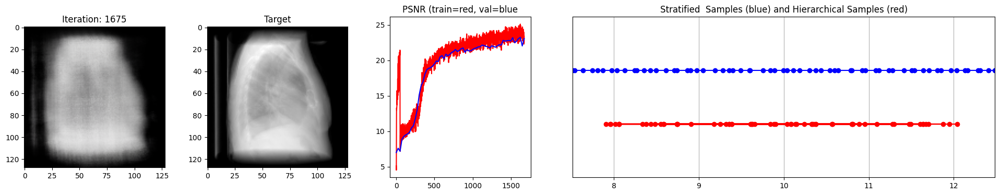

 17%|█▋        | 1700/10000 [10:21<50:23,  2.75it/s]  

Loss: 0.004650803282856941
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


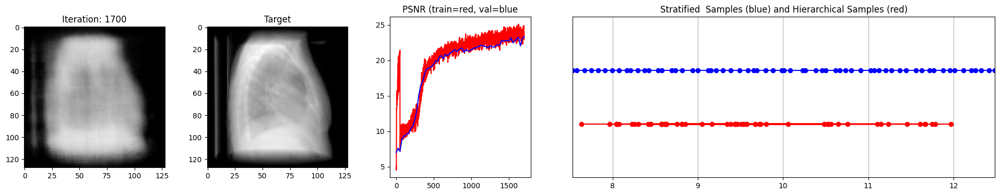

 17%|█▋        | 1725/10000 [10:30<50:32,  2.73it/s]  

Loss: 0.004498351365327835
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


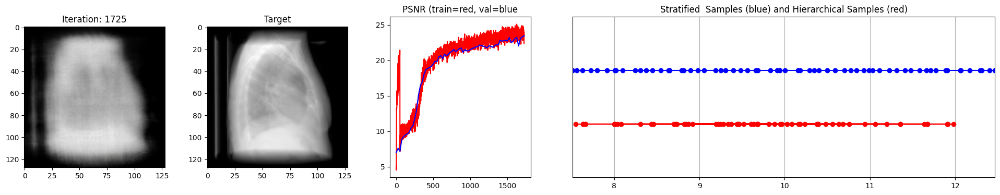

 18%|█▊        | 1750/10000 [10:39<50:08,  2.74it/s]  

Loss: 0.004733004607260227
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


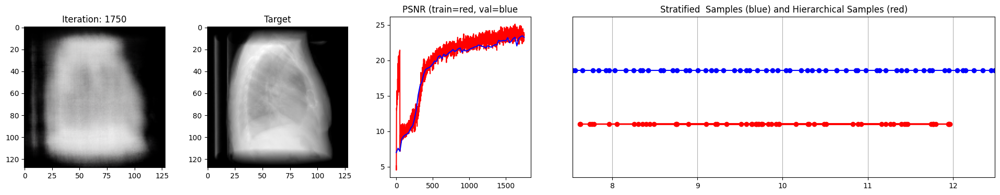

 18%|█▊        | 1775/10000 [10:49<50:05,  2.74it/s]  

Loss: 0.004325533285737038
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


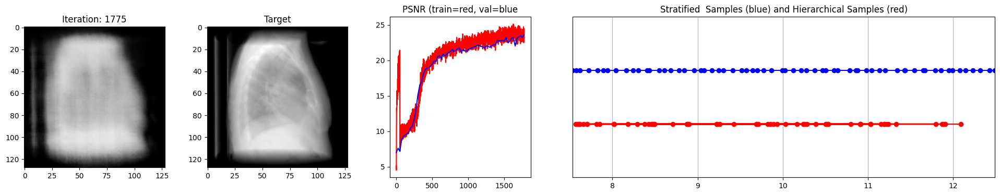

 18%|█▊        | 1800/10000 [10:58<50:13,  2.72it/s]  

Loss: 0.004238118417561054
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


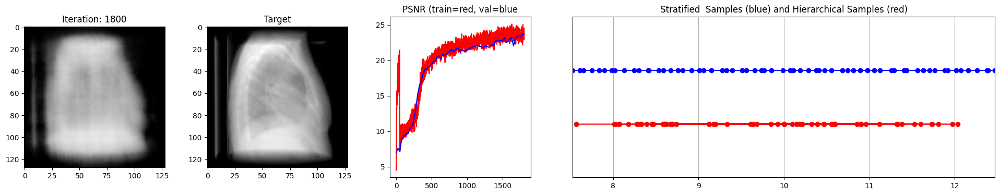

 18%|█▊        | 1825/10000 [11:07<49:49,  2.73it/s]  

Loss: 0.004508285783231258
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


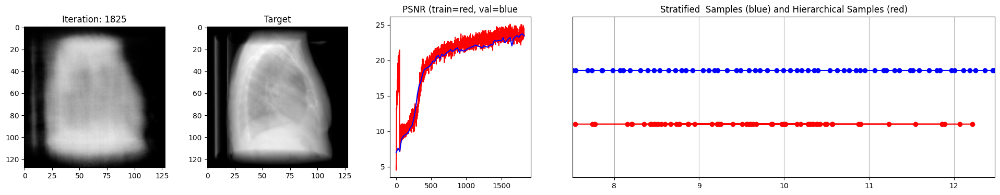

 18%|█▊        | 1850/10000 [11:17<49:13,  2.76it/s]  

Loss: 0.003961893264204264
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


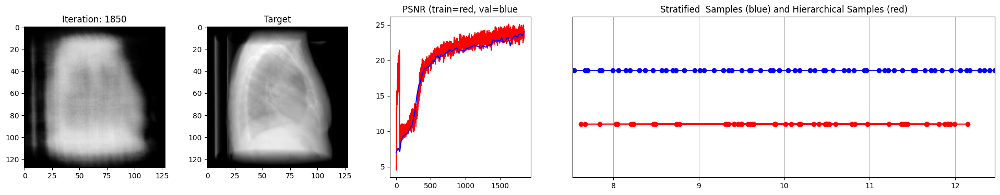

 19%|█▉        | 1875/10000 [11:26<49:29,  2.74it/s]  

Loss: 0.005048863124102354
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


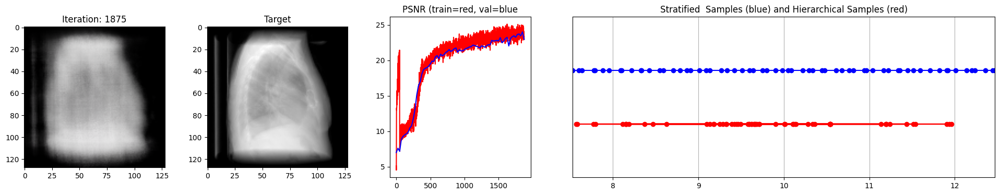

 19%|█▉        | 1900/10000 [11:35<49:26,  2.73it/s]  

Loss: 0.004345828667283058
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


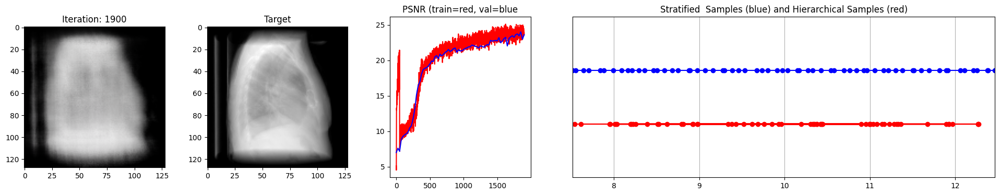

 19%|█▉        | 1925/10000 [11:44<49:27,  2.72it/s]  

Loss: 0.004556951578706503
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


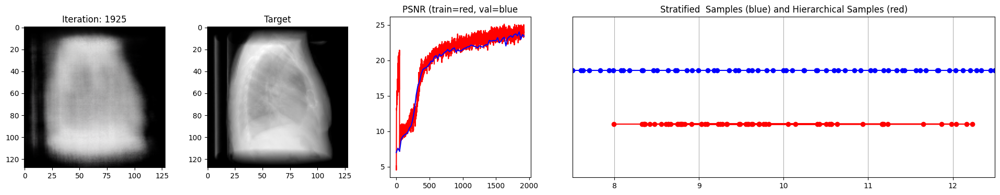

 20%|█▉        | 1950/10000 [11:54<49:09,  2.73it/s]  

Loss: 0.004485481418669224
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


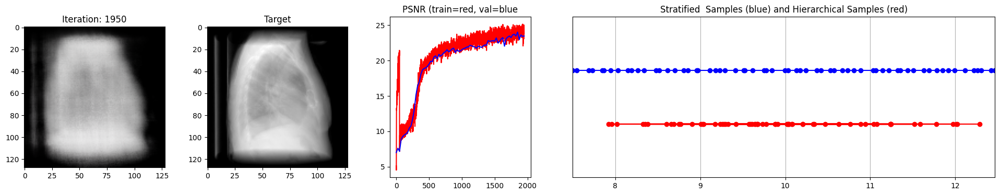

 20%|█▉        | 1975/10000 [12:03<48:57,  2.73it/s]  

Loss: 0.004582298919558525
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


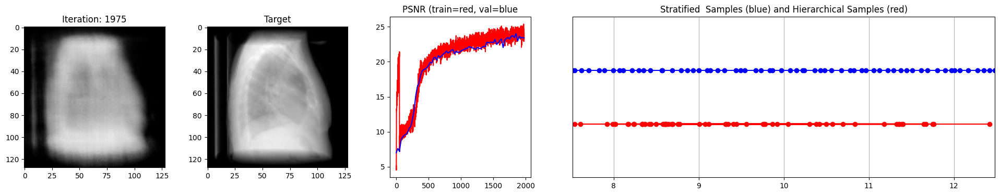

 20%|██        | 2000/10000 [12:12<48:32,  2.75it/s]  

Loss: 0.00448642997071147
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


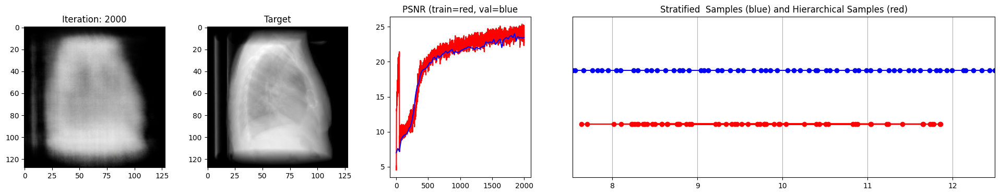

 20%|██        | 2025/10000 [12:22<48:18,  2.75it/s]  

Loss: 0.004777092486619949
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


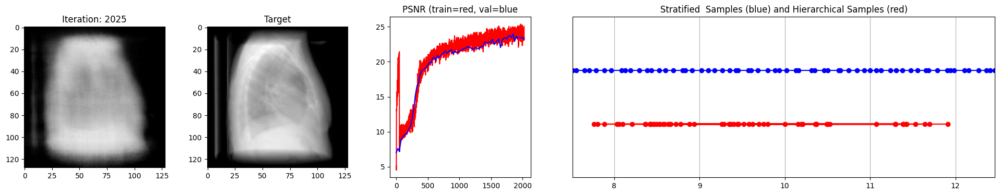

 20%|██        | 2050/10000 [12:31<48:34,  2.73it/s]  

Loss: 0.0047857146710157394
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


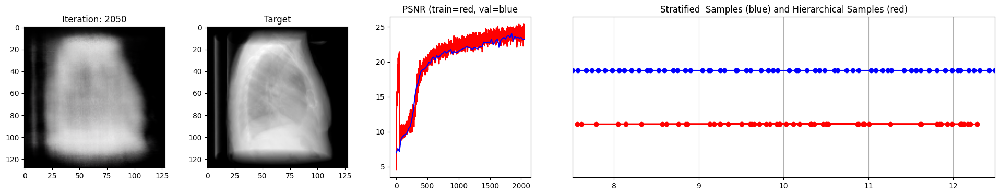

 21%|██        | 2075/10000 [12:40<48:20,  2.73it/s]  

Loss: 0.0047939615324139595
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


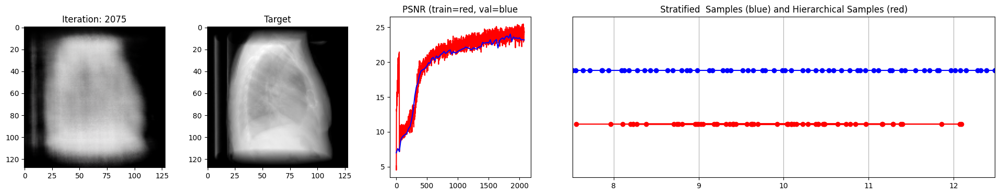

 21%|██        | 2100/10000 [12:49<48:18,  2.73it/s]  

Loss: 0.004512581042945385
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


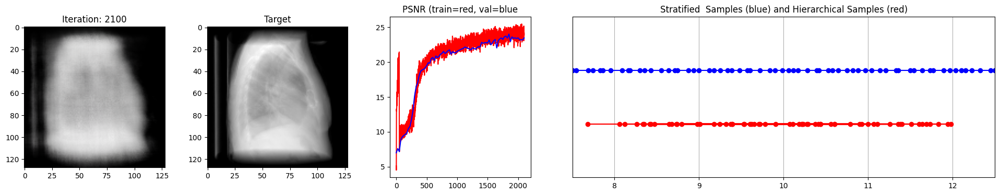

 21%|██▏       | 2125/10000 [12:59<48:06,  2.73it/s]  

Loss: 0.004541950300335884
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


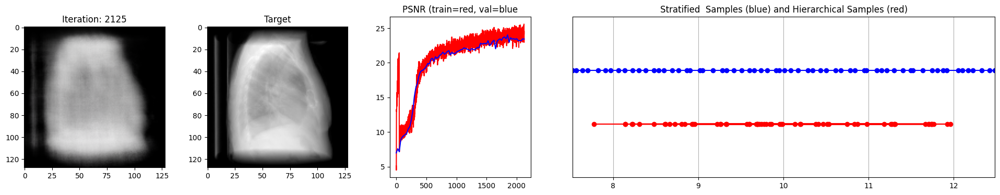

 22%|██▏       | 2150/10000 [13:08<47:34,  2.75it/s]  

Loss: 0.004159348085522652
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


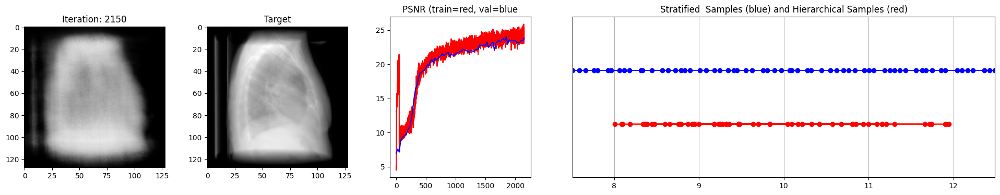

 22%|██▏       | 2175/10000 [13:17<47:36,  2.74it/s]  

Loss: 0.004435773007571697
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


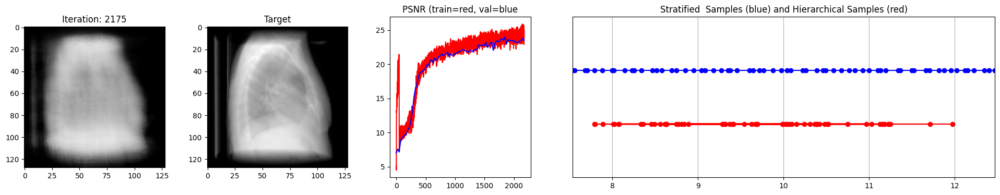

 22%|██▏       | 2200/10000 [13:27<47:41,  2.73it/s]  

Loss: 0.004324966110289097
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


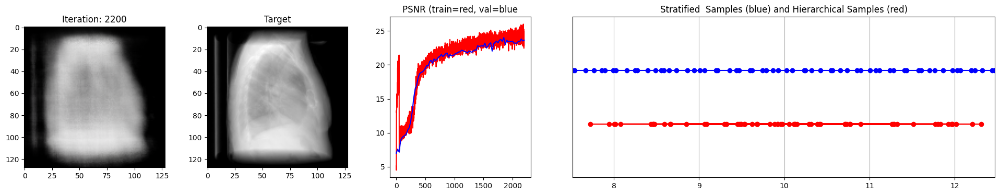

 22%|██▏       | 2225/10000 [13:36<47:39,  2.72it/s]  

Loss: 0.0044556064531207085
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


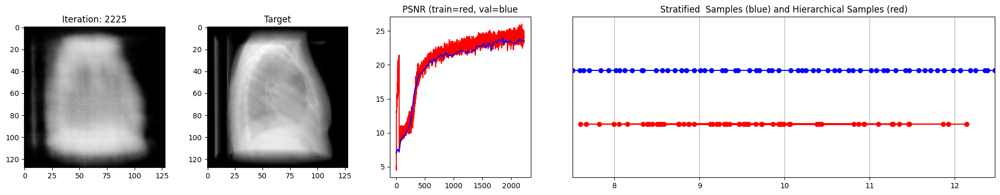

 22%|██▎       | 2250/10000 [13:45<47:14,  2.73it/s]  

Loss: 0.003767027286812663
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


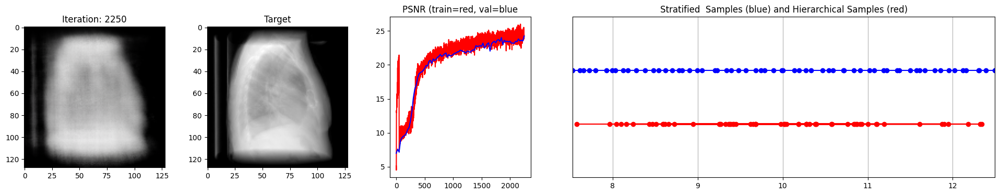

 23%|██▎       | 2275/10000 [13:55<47:02,  2.74it/s]  

Loss: 0.003841141238808632
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


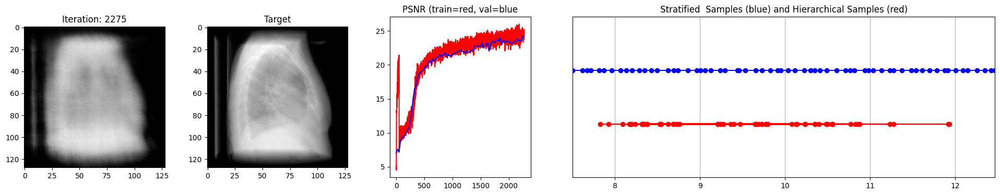

 23%|██▎       | 2300/10000 [14:04<46:48,  2.74it/s]  

Loss: 0.00458937045186758
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


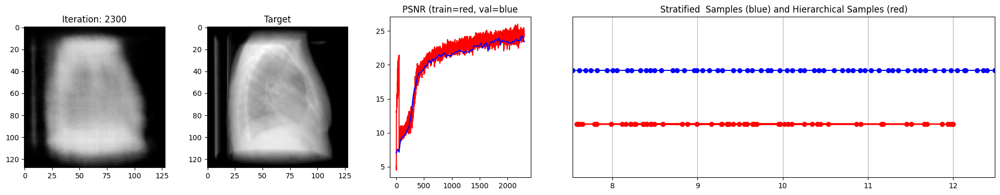

 23%|██▎       | 2325/10000 [14:13<46:53,  2.73it/s]  

Loss: 0.004266792442649603
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


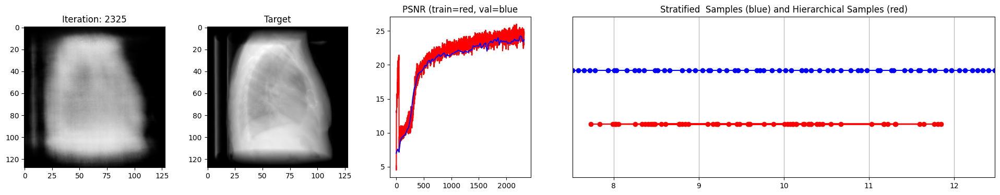

 24%|██▎       | 2350/10000 [14:22<46:42,  2.73it/s]  

Loss: 0.004821521695703268
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


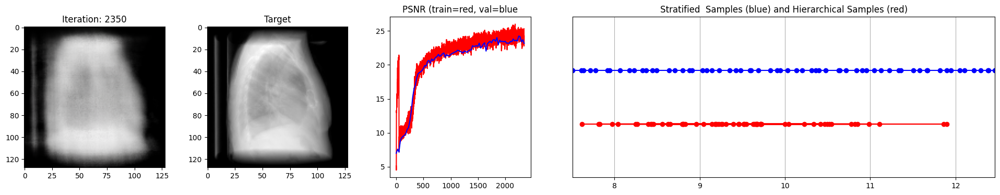

 24%|██▍       | 2375/10000 [14:32<46:27,  2.74it/s]  

Loss: 0.004181969445198774
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


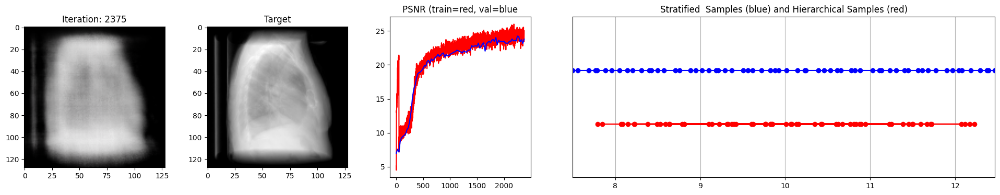

 24%|██▍       | 2400/10000 [14:41<46:26,  2.73it/s]  

Loss: 0.004223543684929609
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


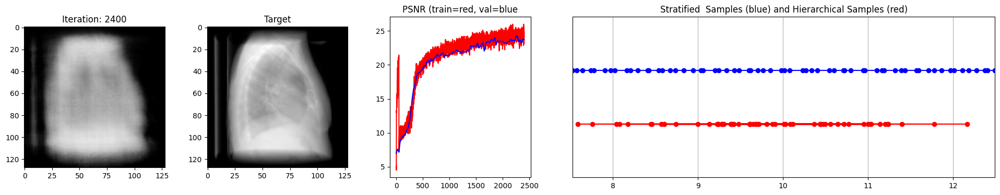

 24%|██▍       | 2425/10000 [14:50<46:22,  2.72it/s]  

Loss: 0.004227267578244209
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


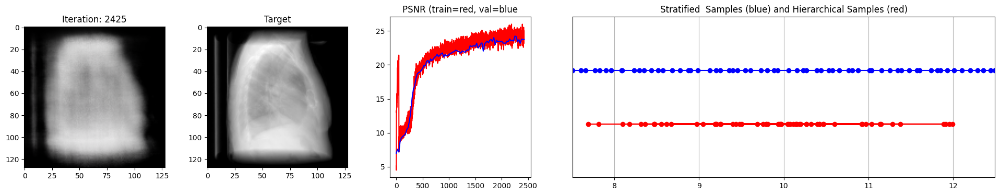

 24%|██▍       | 2450/10000 [15:00<46:08,  2.73it/s]  

Loss: 0.0040025594644248486
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


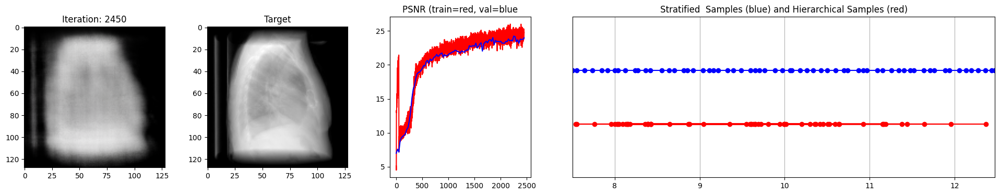

 25%|██▍       | 2475/10000 [15:09<46:10,  2.72it/s]  

Loss: 0.005548318848013878
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


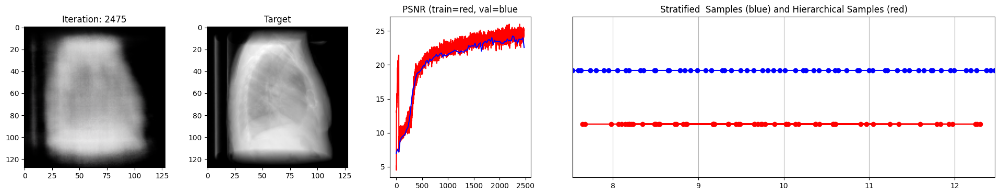

 25%|██▌       | 2500/10000 [15:18<45:55,  2.72it/s]  

Loss: 0.003915938548743725
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


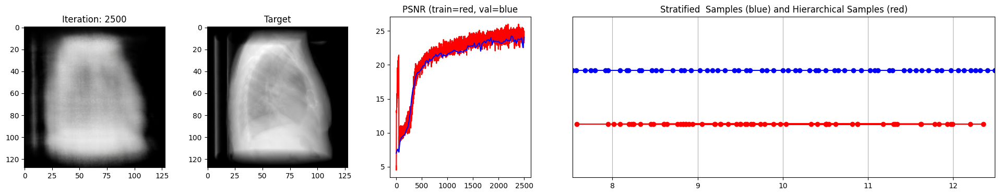

 25%|██▌       | 2525/10000 [15:28<45:36,  2.73it/s]  

Loss: 0.004002464469522238
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


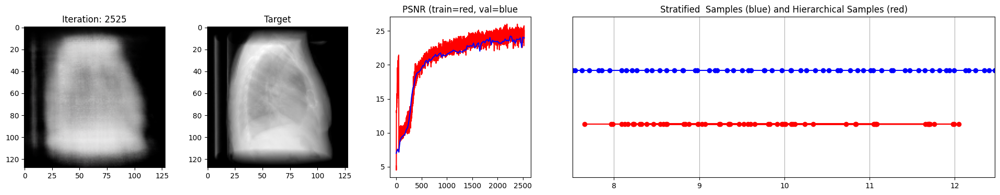

 26%|██▌       | 2550/10000 [15:37<45:41,  2.72it/s]  

Loss: 0.004685922525823116
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


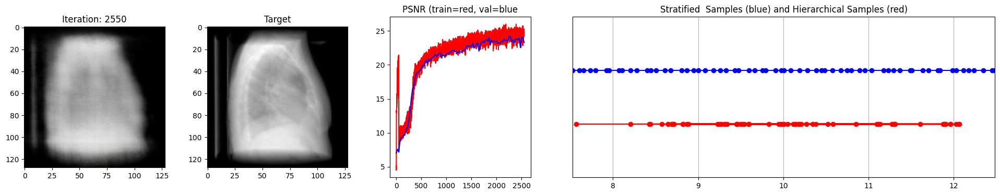

 26%|██▌       | 2575/10000 [15:46<45:27,  2.72it/s]  

Loss: 0.004422390833497047
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


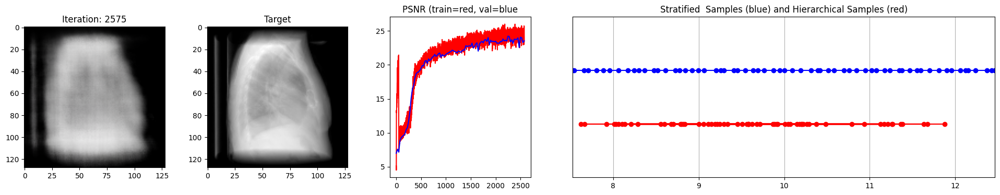

 26%|██▌       | 2600/10000 [15:55<45:09,  2.73it/s]  

Loss: 0.004194721579551697
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


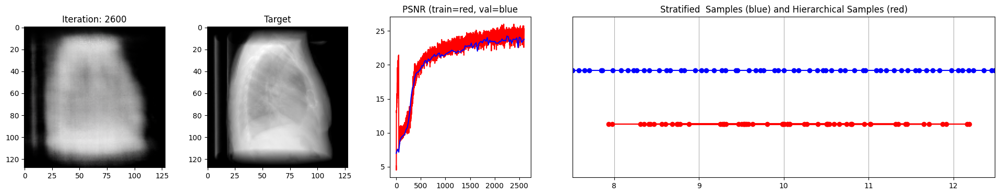

 26%|██▋       | 2625/10000 [16:05<45:33,  2.70it/s]  

Loss: 0.004061406943947077
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


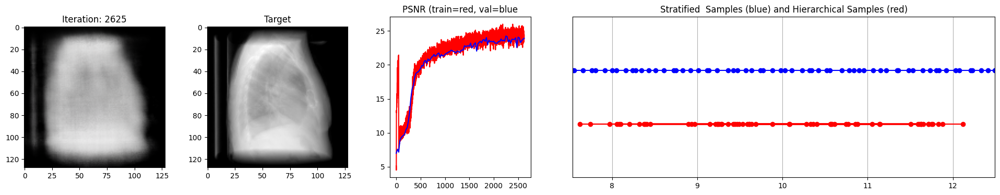

 26%|██▋       | 2650/10000 [16:14<45:06,  2.72it/s]  

Loss: 0.003659474430605769
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


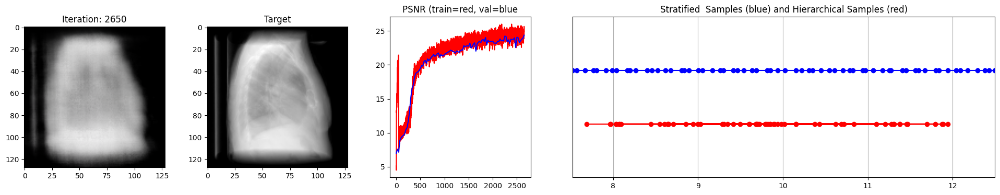

 27%|██▋       | 2675/10000 [16:23<44:39,  2.73it/s]  

Loss: 0.003369682002812624
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


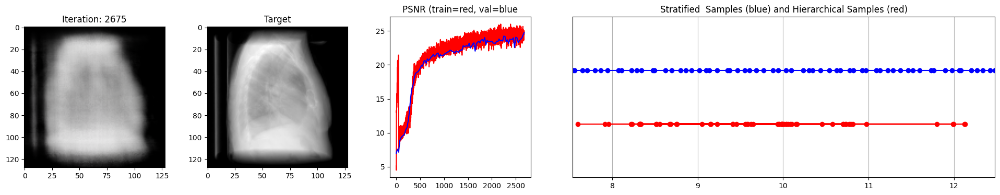

 27%|██▋       | 2700/10000 [16:33<44:25,  2.74it/s]  

Loss: 0.003520280122756958
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


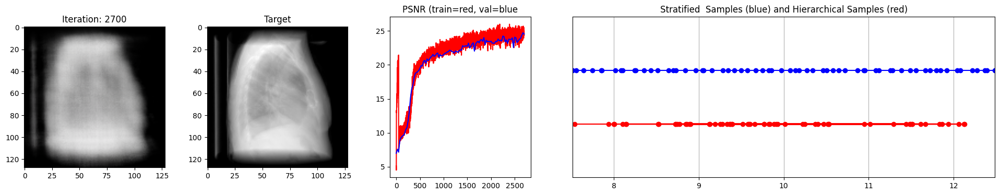

 27%|██▋       | 2725/10000 [16:42<44:14,  2.74it/s]  

Loss: 0.004214635118842125
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


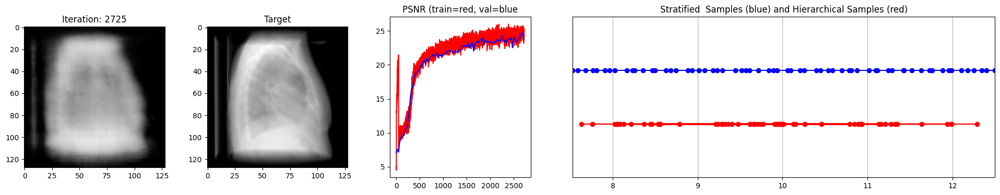

 28%|██▊       | 2750/10000 [16:51<44:07,  2.74it/s]  

Loss: 0.0037178616039454937
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


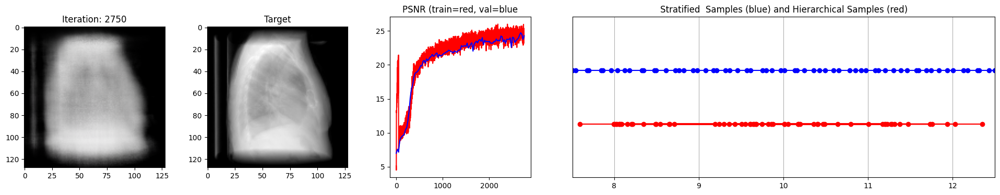

 28%|██▊       | 2775/10000 [17:00<44:13,  2.72it/s]  

Loss: 0.004036500584334135
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


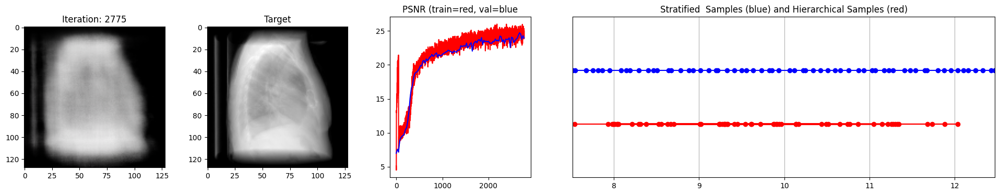

 28%|██▊       | 2800/10000 [17:10<43:41,  2.75it/s]  

Loss: 0.0038859769701957703
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


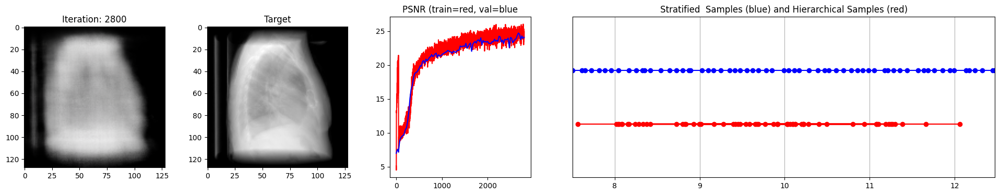

 28%|██▊       | 2825/10000 [17:19<43:36,  2.74it/s]  

Loss: 0.004174312576651573
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


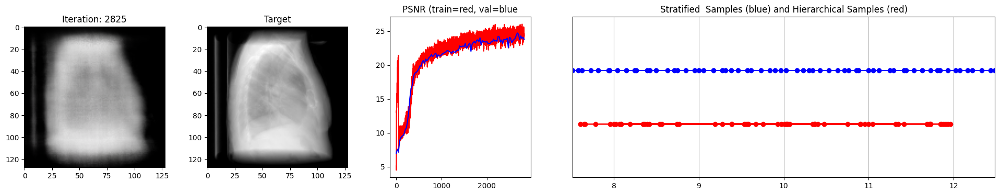

 28%|██▊       | 2850/10000 [17:28<43:44,  2.72it/s]  

Loss: 0.003773558884859085
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


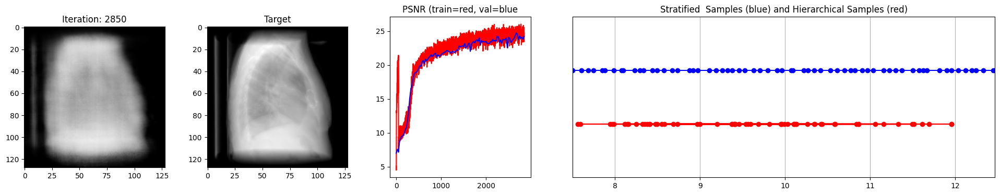

 29%|██▉       | 2875/10000 [17:38<43:22,  2.74it/s]  

Loss: 0.0037540560588240623
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


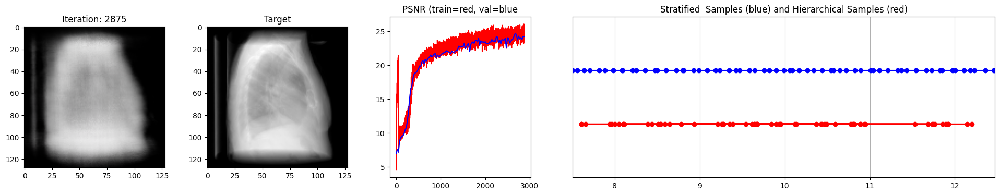

 29%|██▉       | 2900/10000 [17:47<43:09,  2.74it/s]  

Loss: 0.005770369432866573
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


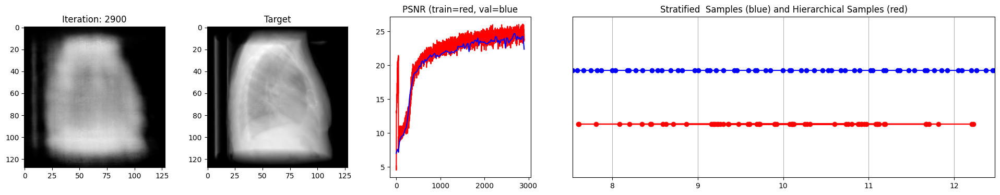

 29%|██▉       | 2925/10000 [17:56<43:08,  2.73it/s]  

Loss: 0.00420339684933424
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


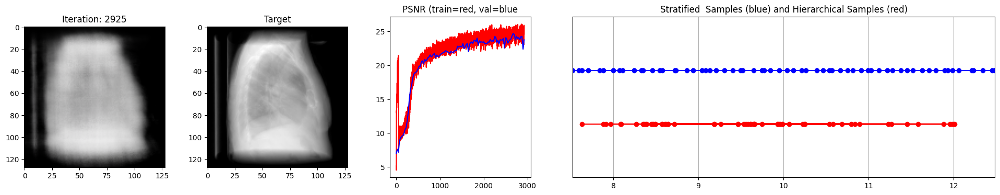

 30%|██▉       | 2950/10000 [18:06<42:55,  2.74it/s]  

Loss: 0.003911701962351799
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


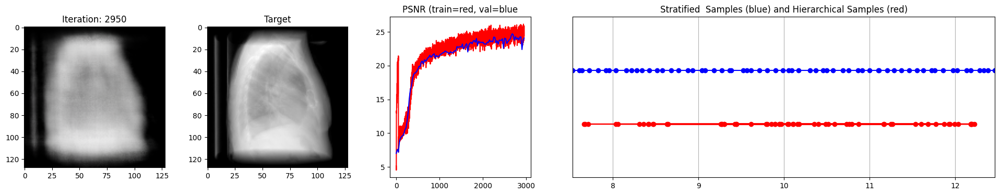

 30%|██▉       | 2975/10000 [18:15<42:56,  2.73it/s]  

Loss: 0.0036985359620302916
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


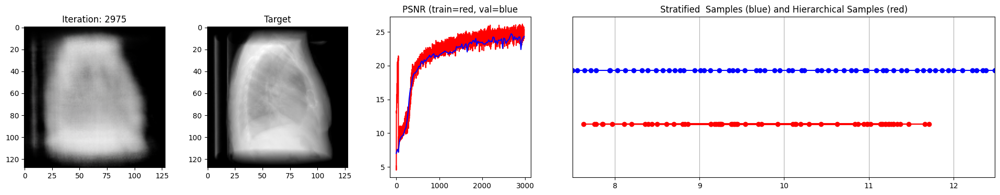

 30%|███       | 3000/10000 [18:24<42:28,  2.75it/s]  

Loss: 0.0037709116004407406
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


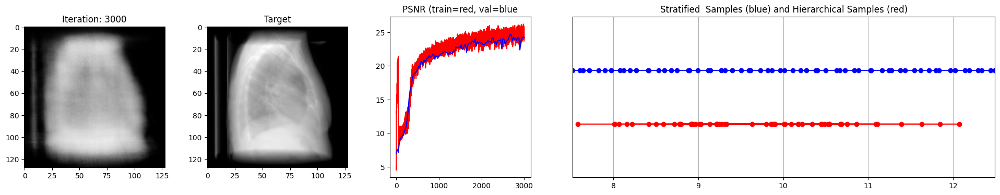

 30%|███       | 3025/10000 [18:33<42:08,  2.76it/s]  

Loss: 0.003811369650065899
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


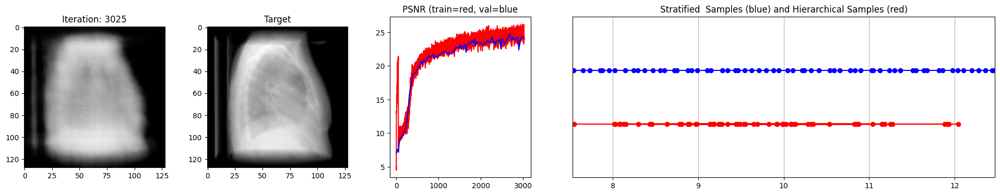

 30%|███       | 3050/10000 [18:42<41:57,  2.76it/s]  

Loss: 0.004202413372695446
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


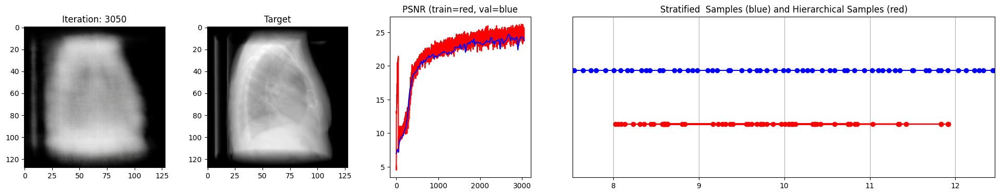

 31%|███       | 3075/10000 [18:52<41:45,  2.76it/s]  

Loss: 0.005133252590894699
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


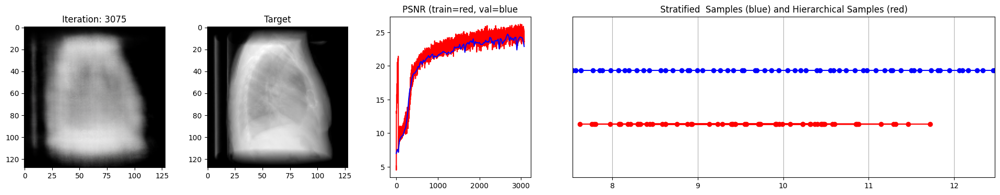

 31%|███       | 3100/10000 [19:01<41:29,  2.77it/s]  

Loss: 0.003753410652279854
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


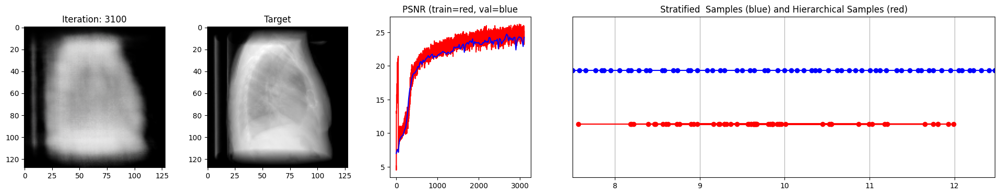

 31%|███▏      | 3125/10000 [19:10<41:26,  2.77it/s]

Loss: 0.0037300800904631615
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


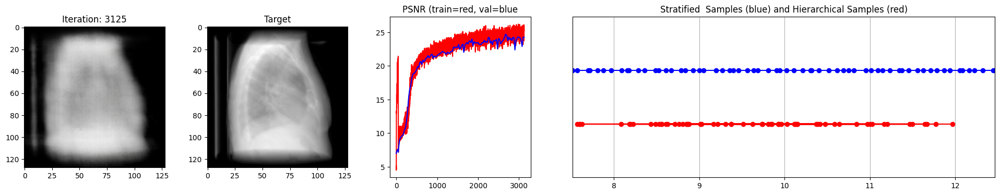

 32%|███▏      | 3150/10000 [19:19<41:17,  2.76it/s]

Loss: 0.0037470809184014797
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


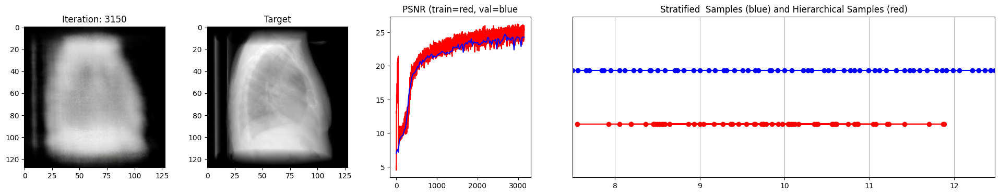

 32%|███▏      | 3175/10000 [19:28<41:15,  2.76it/s]

Loss: 0.003473840653896332
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


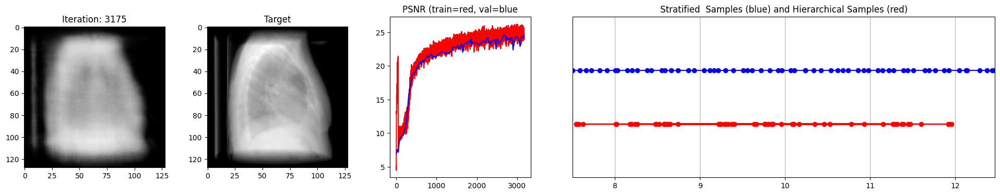

 32%|███▏      | 3200/10000 [19:37<41:01,  2.76it/s]

Loss: 0.0038524752017110586
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


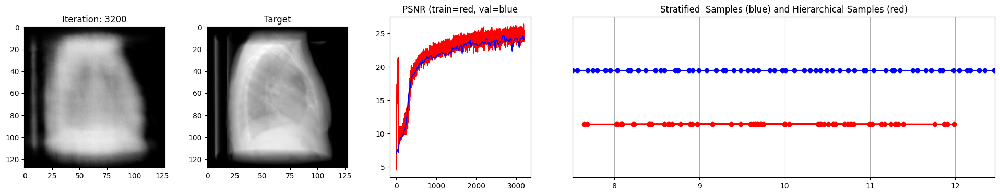

 32%|███▏      | 3225/10000 [19:47<40:57,  2.76it/s]  

Loss: 0.0039451271295547485
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


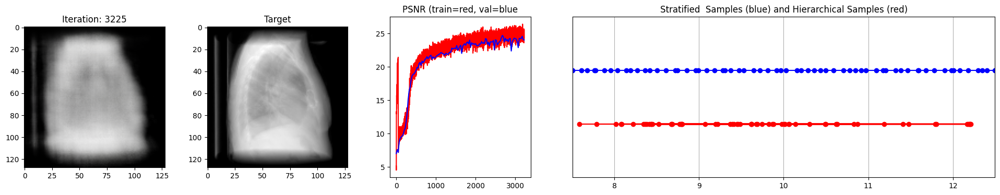

 32%|███▎      | 3250/10000 [19:56<40:54,  2.75it/s]

Loss: 0.003715772880241275
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


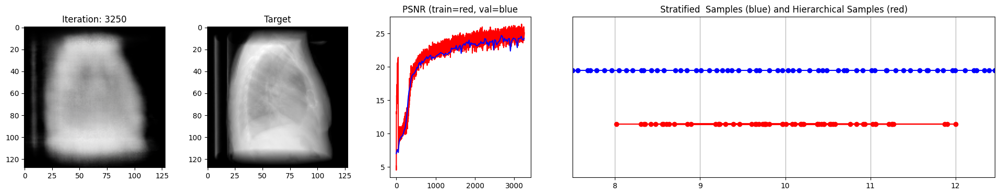

 33%|███▎      | 3275/10000 [20:05<40:40,  2.76it/s]

Loss: 0.0037782422732561827
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


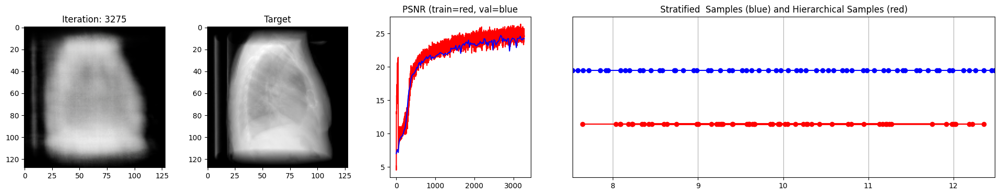

 33%|███▎      | 3300/10000 [20:14<40:22,  2.77it/s]

Loss: 0.004371849820017815
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


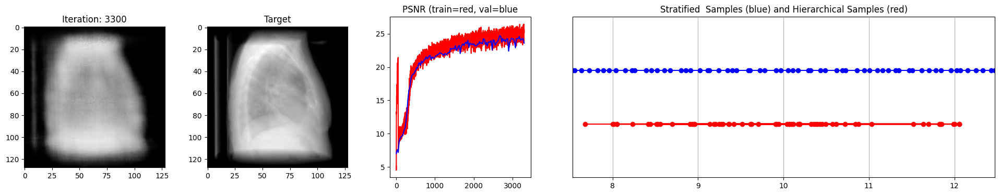

 33%|███▎      | 3325/10000 [20:24<40:12,  2.77it/s]

Loss: 0.0035532303154468536
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


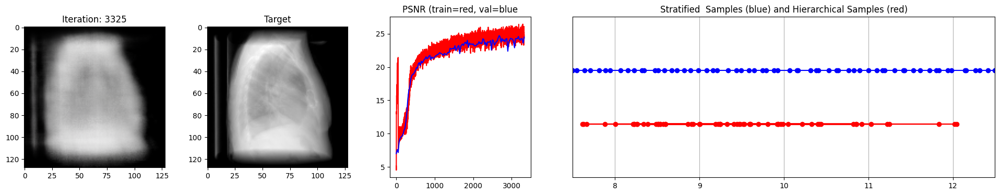

 34%|███▎      | 3350/10000 [20:33<40:15,  2.75it/s]

Loss: 0.0038760125171393156
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


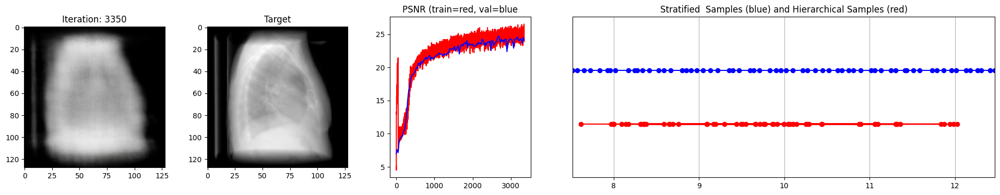

 34%|███▍      | 3375/10000 [20:42<40:12,  2.75it/s]

Loss: 0.004022102802991867
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


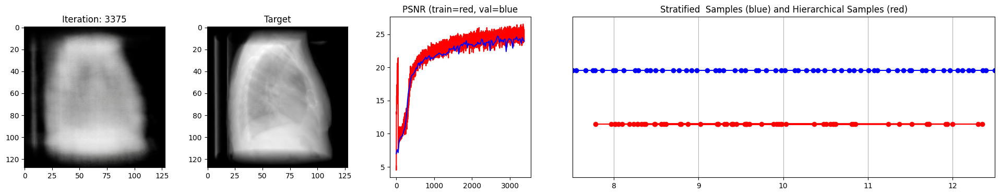

 34%|███▍      | 3400/10000 [20:51<39:54,  2.76it/s]

Loss: 0.003941587172448635
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


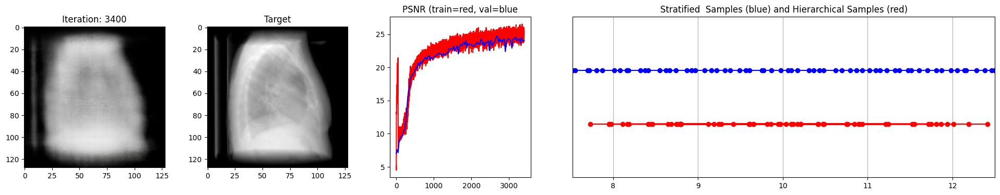

 34%|███▍      | 3425/10000 [21:00<39:31,  2.77it/s]

Loss: 0.003890996566042304
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


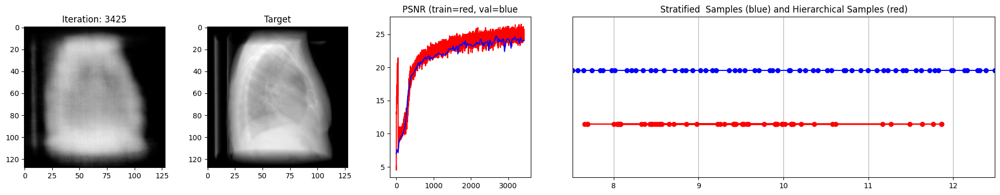

 34%|███▍      | 3450/10000 [21:09<39:29,  2.76it/s]

Loss: 0.003672489430755377
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


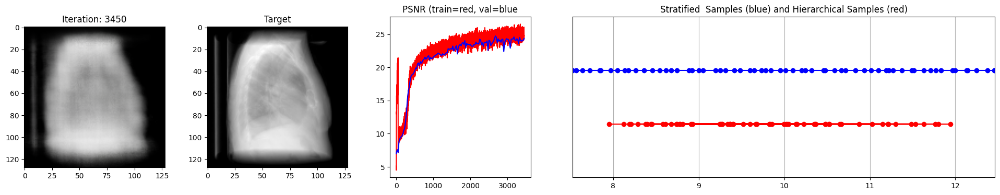

 35%|███▍      | 3475/10000 [21:19<39:16,  2.77it/s]

Loss: 0.003436692990362644
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


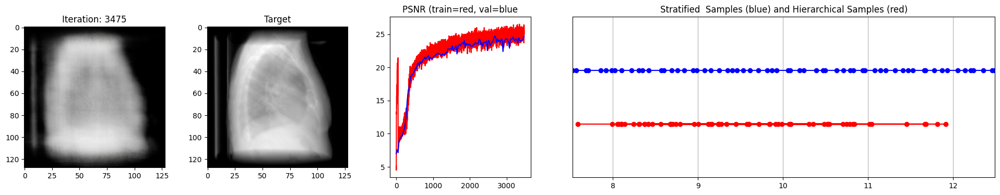

 35%|███▌      | 3500/10000 [21:28<39:24,  2.75it/s]  

Loss: 0.004027549177408218
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


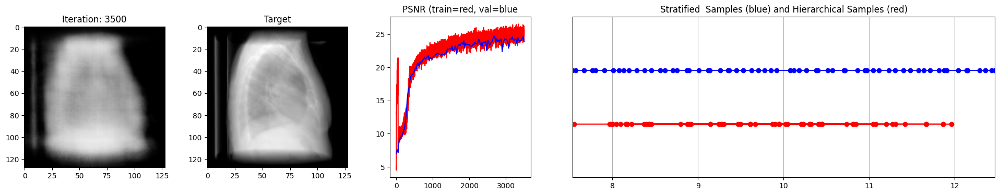

 35%|███▌      | 3525/10000 [21:37<39:19,  2.74it/s]

Loss: 0.0040680221281945705
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


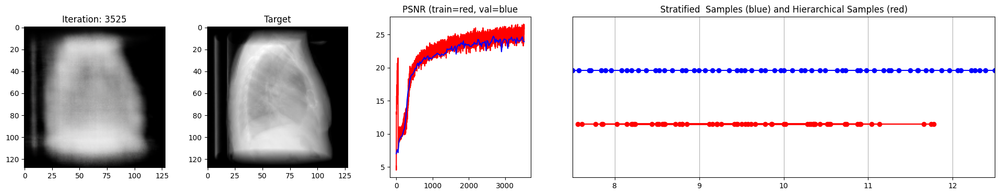

 36%|███▌      | 3550/10000 [21:46<39:06,  2.75it/s]

Loss: 0.0035197369288653135
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


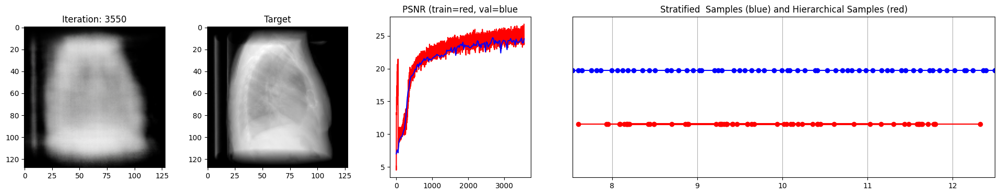

 36%|███▌      | 3575/10000 [21:56<38:58,  2.75it/s]

Loss: 0.003802132559940219
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


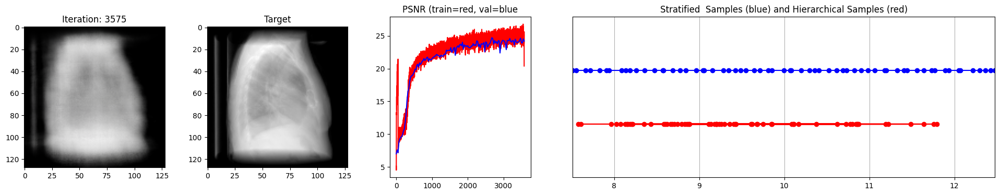

 36%|███▌      | 3600/10000 [22:05<38:47,  2.75it/s]

Loss: 0.004675221163779497
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


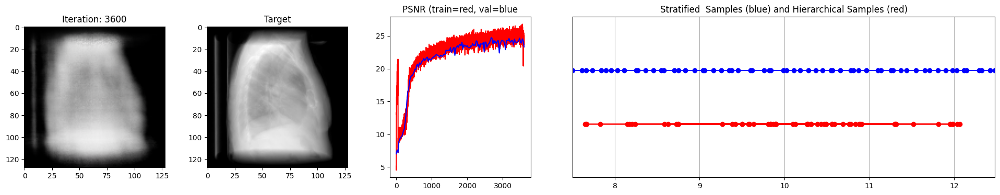

 36%|███▋      | 3625/10000 [22:14<38:29,  2.76it/s]

Loss: 0.0033612046390771866
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


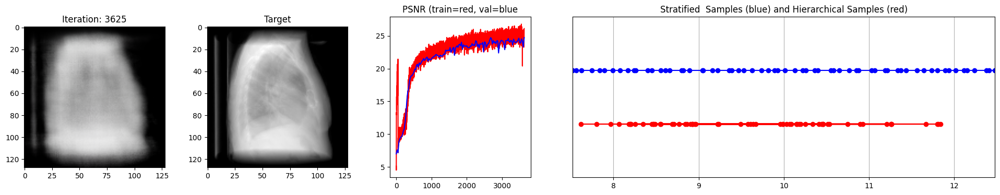

 36%|███▋      | 3650/10000 [22:23<38:24,  2.75it/s]

Loss: 0.0037139132618904114
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


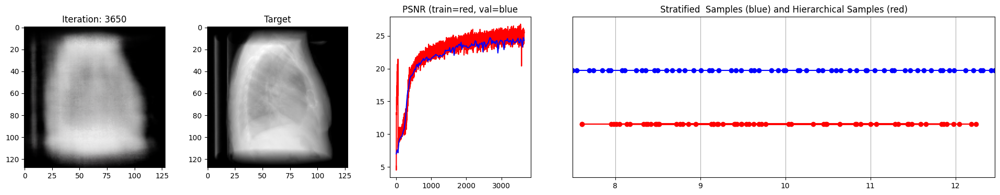

 37%|███▋      | 3675/10000 [22:32<38:20,  2.75it/s]

Loss: 0.004155309870839119
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


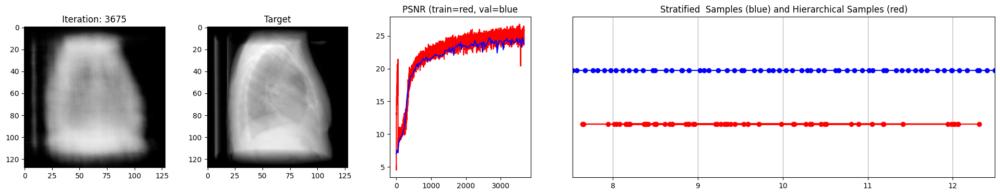

 37%|███▋      | 3700/10000 [22:42<38:10,  2.75it/s]

Loss: 0.003697415580973029
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


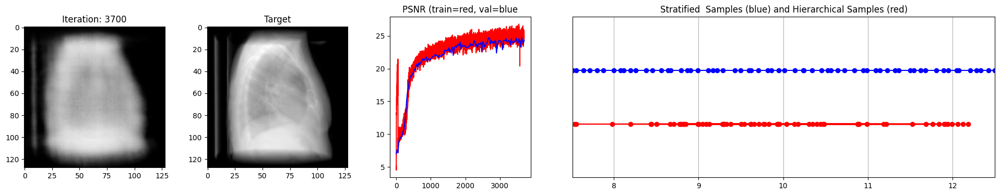

 37%|███▋      | 3725/10000 [22:51<37:49,  2.76it/s]

Loss: 0.003531568218022585
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


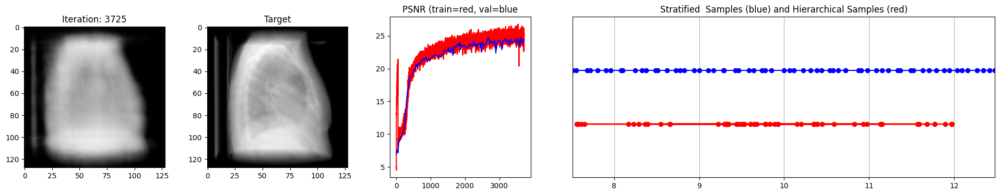

 38%|███▊      | 3750/10000 [23:00<37:50,  2.75it/s]

Loss: 0.0037505491636693478
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


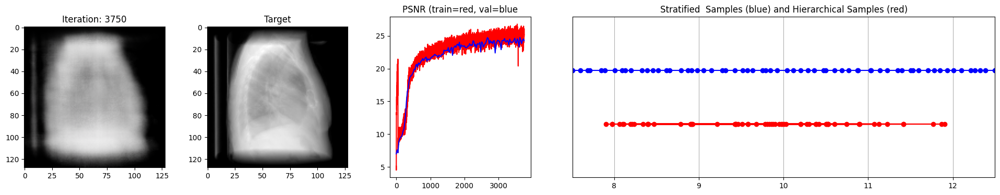

 38%|███▊      | 3775/10000 [23:09<37:42,  2.75it/s]

Loss: 0.003396830288693309
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


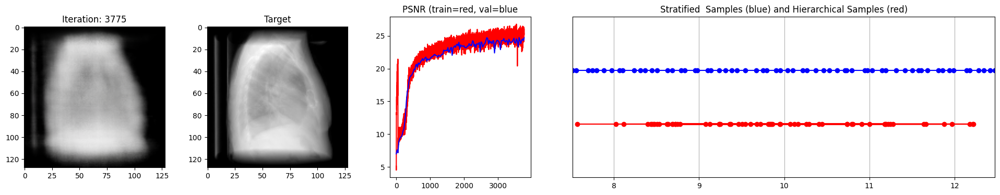

 38%|███▊      | 3800/10000 [23:19<37:20,  2.77it/s]

Loss: 0.0034078664612025023
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


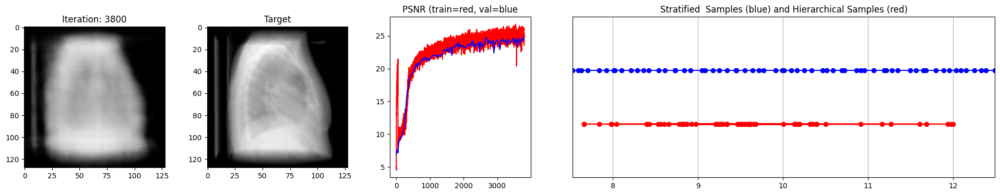

 38%|███▊      | 3825/10000 [23:28<37:21,  2.75it/s]

Loss: 0.003557968884706497
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


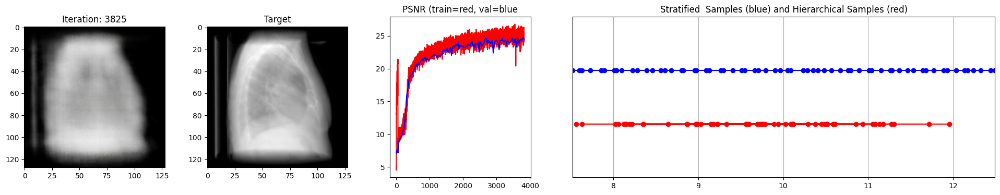

 38%|███▊      | 3850/10000 [23:37<37:06,  2.76it/s]

Loss: 0.003807834116742015
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


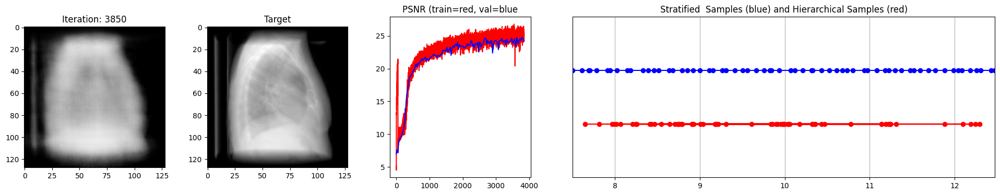

 39%|███▉      | 3875/10000 [23:46<36:55,  2.77it/s]

Loss: 0.0036582692991942167
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


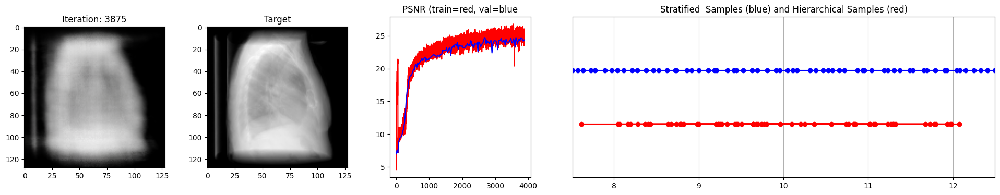

 39%|███▉      | 3900/10000 [23:55<36:43,  2.77it/s]

Loss: 0.003778932150453329
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


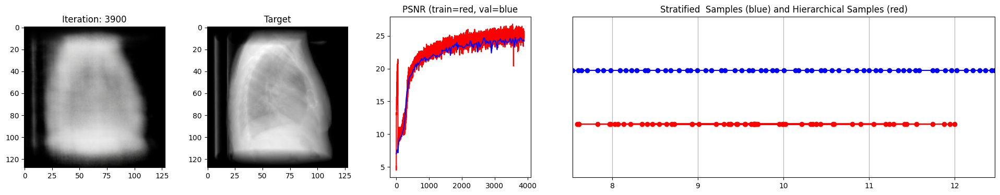

 39%|███▉      | 3925/10000 [24:05<36:40,  2.76it/s]

Loss: 0.0038771105464547873
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


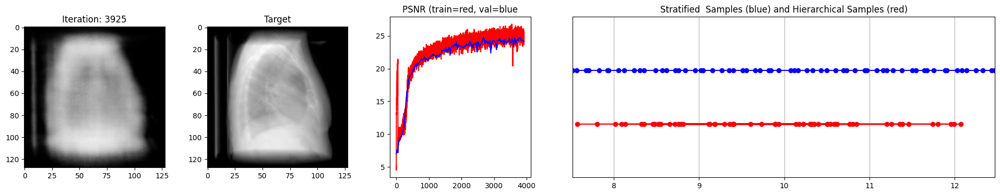

 40%|███▉      | 3950/10000 [24:14<36:36,  2.75it/s]

Loss: 0.003177950158715248
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


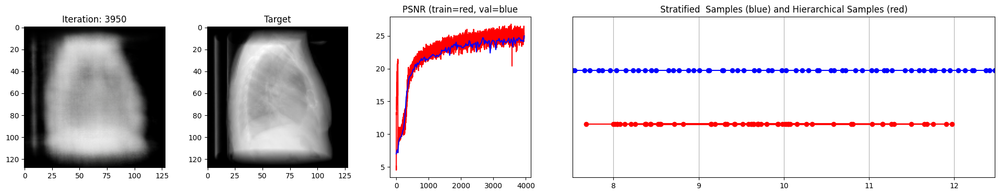

 40%|███▉      | 3975/10000 [24:23<36:15,  2.77it/s]

Loss: 0.0035778568126261234
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


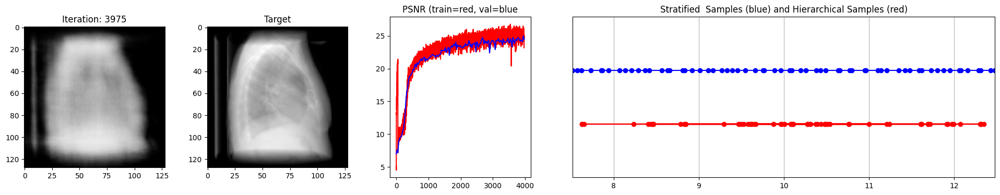

 40%|████      | 4000/10000 [24:32<36:25,  2.74it/s]

Loss: 0.006366913206875324
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


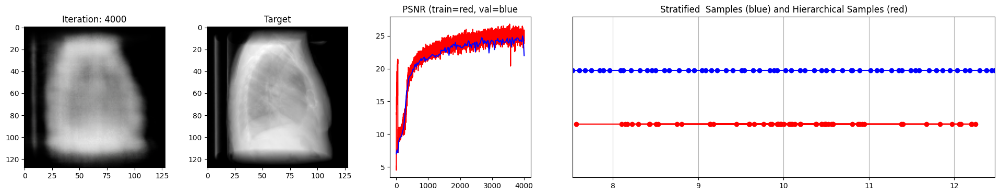

 40%|████      | 4025/10000 [24:42<36:09,  2.75it/s]

Loss: 0.0033271971624344587
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


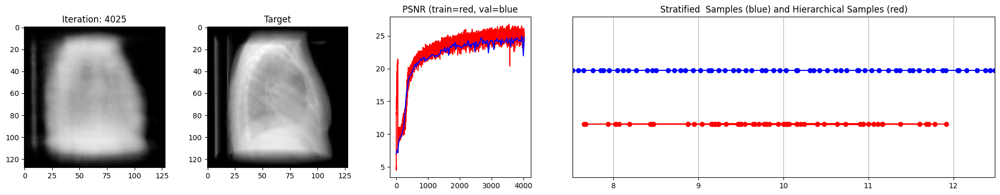

 40%|████      | 4050/10000 [24:51<36:01,  2.75it/s]

Loss: 0.003386269323527813
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


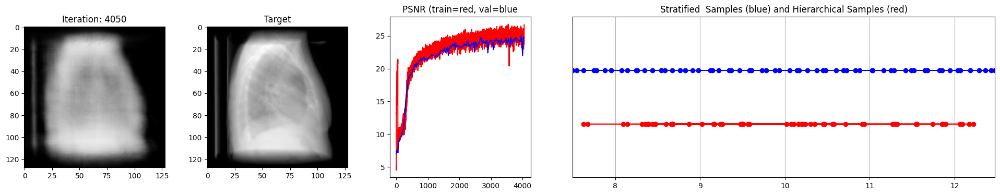

 41%|████      | 4075/10000 [25:00<35:54,  2.75it/s]

Loss: 0.0040508355014026165
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


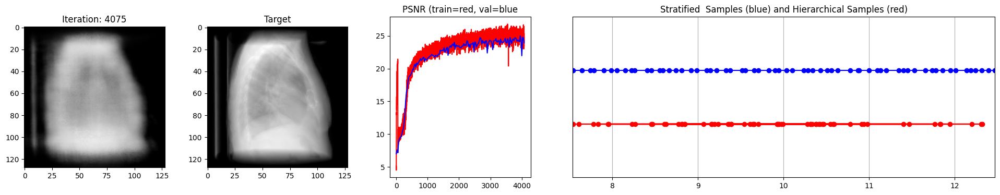

 41%|████      | 4100/10000 [25:09<35:37,  2.76it/s]

Loss: 0.0039447457529604435
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


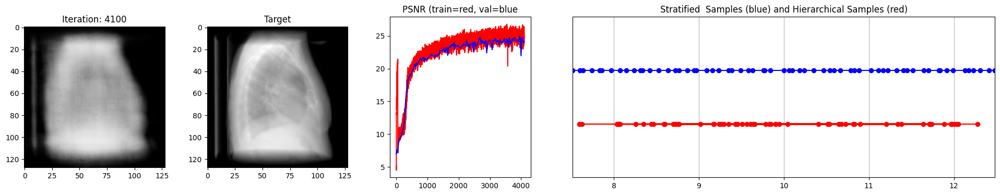

 41%|████▏     | 4125/10000 [25:19<35:38,  2.75it/s]

Loss: 0.0036696637980639935
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


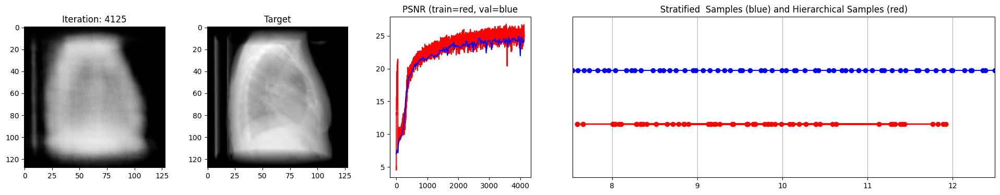

 42%|████▏     | 4150/10000 [25:28<35:25,  2.75it/s]

Loss: 0.003567749634385109
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


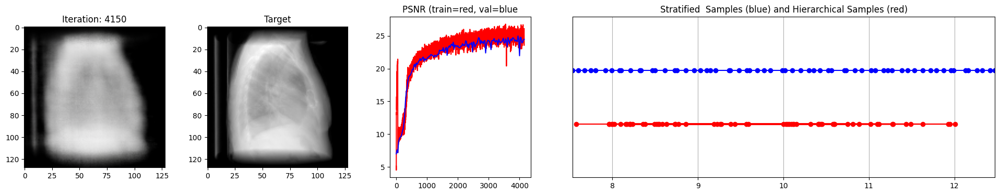

 42%|████▏     | 4175/10000 [25:37<35:06,  2.77it/s]

Loss: 0.003399862674996257
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


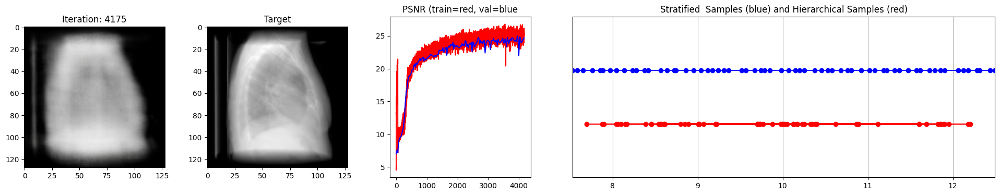

 42%|████▏     | 4200/10000 [25:46<35:02,  2.76it/s]

Loss: 0.0031435329001396894
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


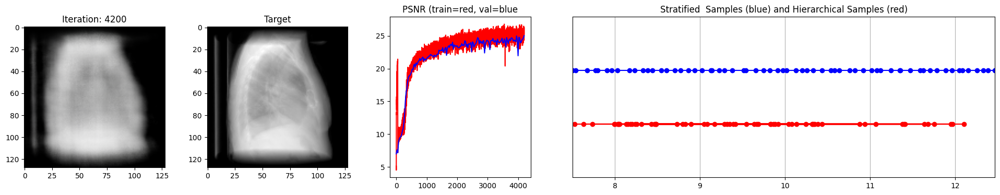

 42%|████▏     | 4225/10000 [25:55<35:01,  2.75it/s]

Loss: 0.0029193670488893986
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


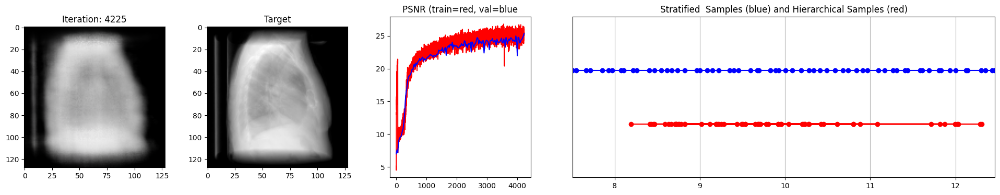

 42%|████▎     | 4250/10000 [26:05<34:42,  2.76it/s]

Loss: 0.003478758968412876
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


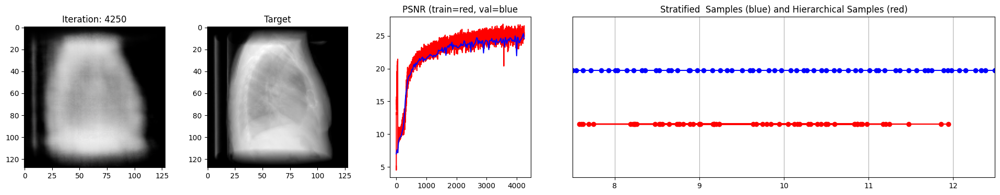

 43%|████▎     | 4275/10000 [26:14<34:41,  2.75it/s]

Loss: 0.003565373830497265
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


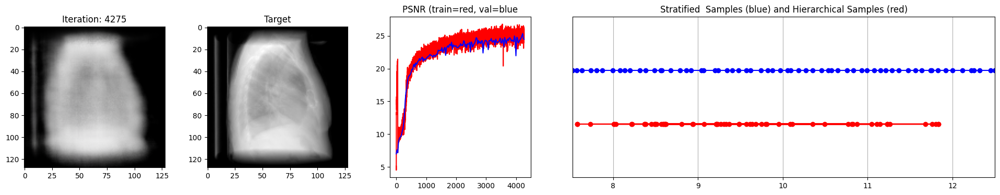

 43%|████▎     | 4300/10000 [26:23<34:32,  2.75it/s]

Loss: 0.004251180216670036
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


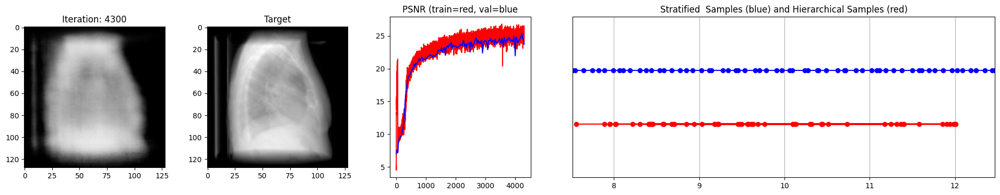

 43%|████▎     | 4325/10000 [26:32<34:21,  2.75it/s]

Loss: 0.003937821369618177
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


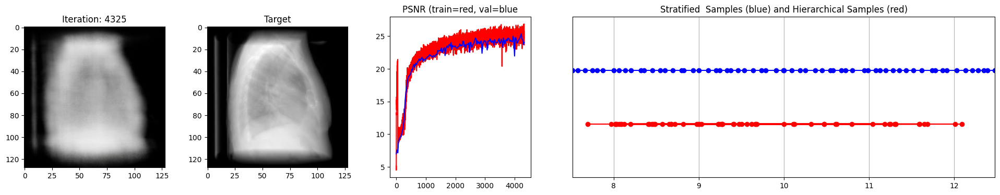

 44%|████▎     | 4350/10000 [26:42<34:01,  2.77it/s]

Loss: 0.004035514779388905
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


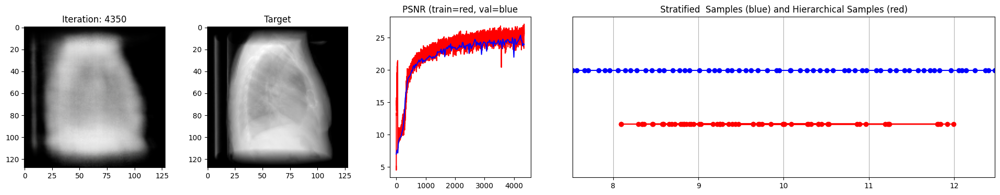

 44%|████▍     | 4375/10000 [26:51<34:01,  2.76it/s]

Loss: 0.003611696884036064
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


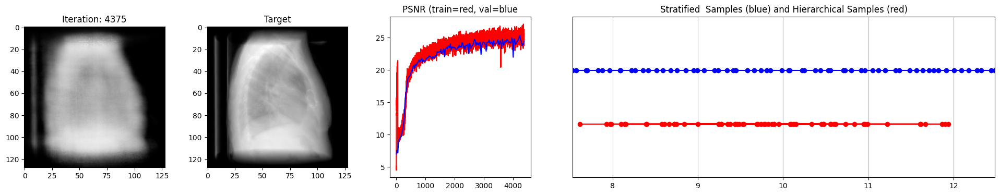

 44%|████▍     | 4400/10000 [27:00<33:41,  2.77it/s]

Loss: 0.003759559942409396
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


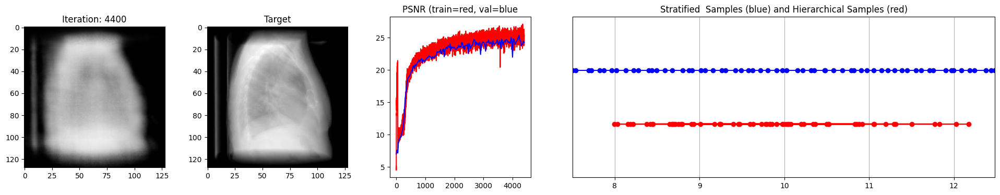

 44%|████▍     | 4425/10000 [27:10<33:40,  2.76it/s]

Loss: 0.003671522717922926
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


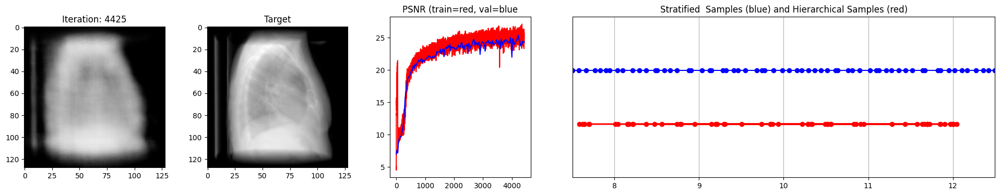

 44%|████▍     | 4450/10000 [27:19<33:34,  2.76it/s]

Loss: 0.003379854140803218
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


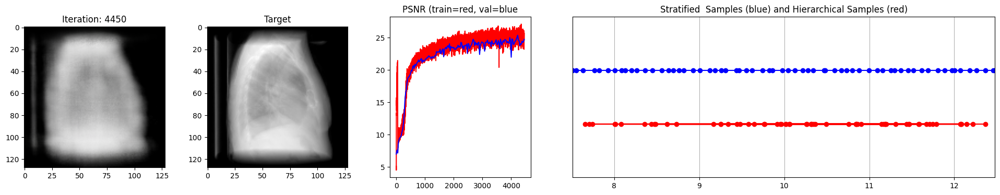

 45%|████▍     | 4475/10000 [27:28<33:23,  2.76it/s]

Loss: 0.0036388977896422148
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


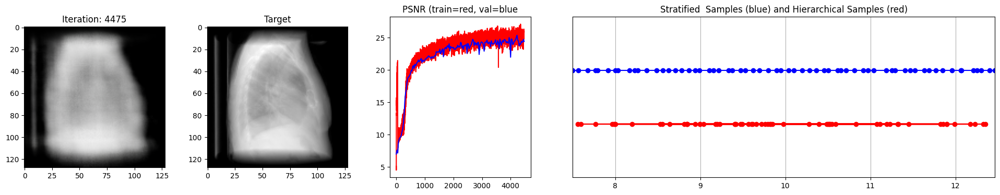

 45%|████▌     | 4500/10000 [27:37<33:15,  2.76it/s]

Loss: 0.003031719010323286
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


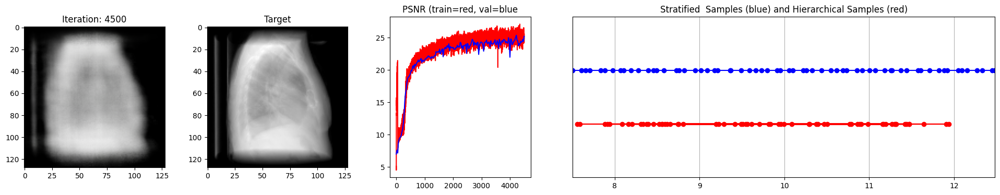

 45%|████▌     | 4525/10000 [27:46<33:26,  2.73it/s]

Loss: 0.0039312103763222694
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


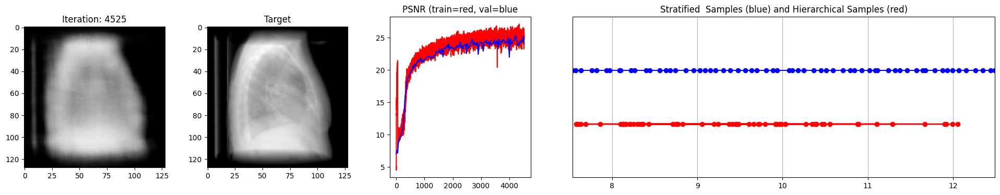

 46%|████▌     | 4550/10000 [27:56<33:15,  2.73it/s]

Loss: 0.0029255198314785957
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


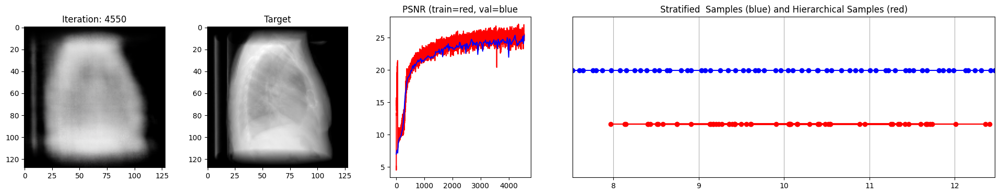

 46%|████▌     | 4575/10000 [28:05<33:04,  2.73it/s]

Loss: 0.003379142377525568
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


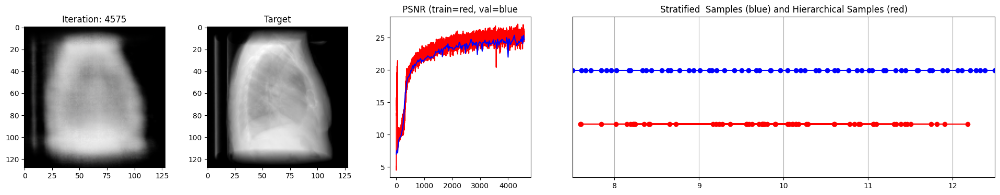

 46%|████▌     | 4600/10000 [28:14<32:58,  2.73it/s]

Loss: 0.003374748630449176
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


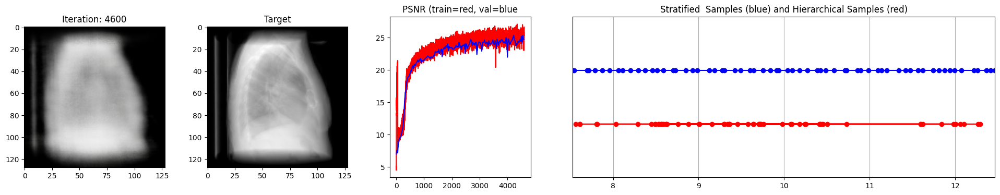

 46%|████▋     | 4625/10000 [28:24<32:42,  2.74it/s]

Loss: 0.003341208677738905
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


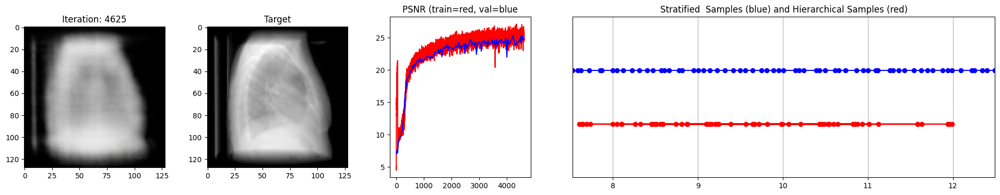

 46%|████▋     | 4650/10000 [28:33<32:35,  2.74it/s]

Loss: 0.002890652045607567
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


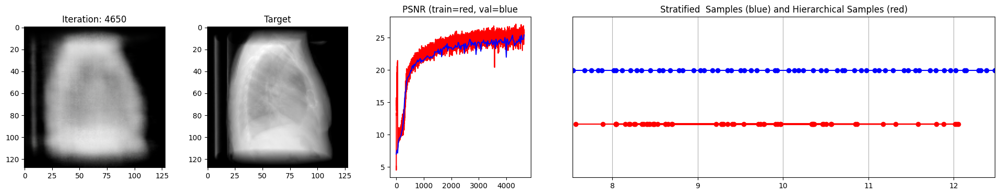

 47%|████▋     | 4675/10000 [28:43<32:22,  2.74it/s]

Loss: 0.0032194512896239758
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


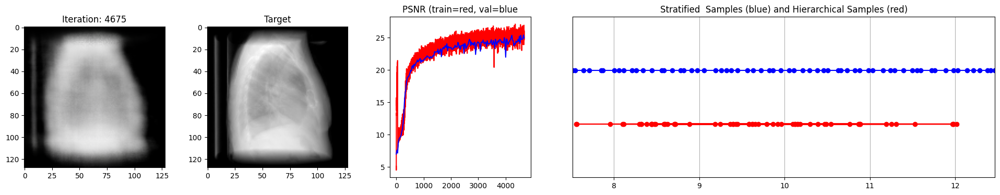

 47%|████▋     | 4700/10000 [28:52<32:29,  2.72it/s]

Loss: 0.0030579715967178345
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


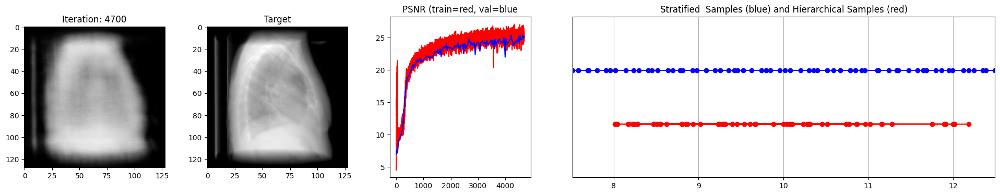

 47%|████▋     | 4725/10000 [29:02<32:19,  2.72it/s]

Loss: 0.003316562157124281
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


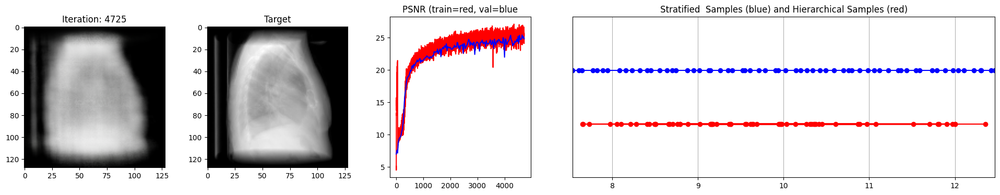

 48%|████▊     | 4750/10000 [29:11<31:57,  2.74it/s]

Loss: 0.003286633174866438
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


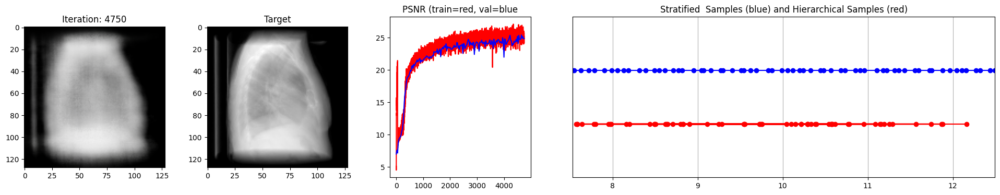

 48%|████▊     | 4775/10000 [29:21<31:55,  2.73it/s]

Loss: 0.0033916980028152466
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


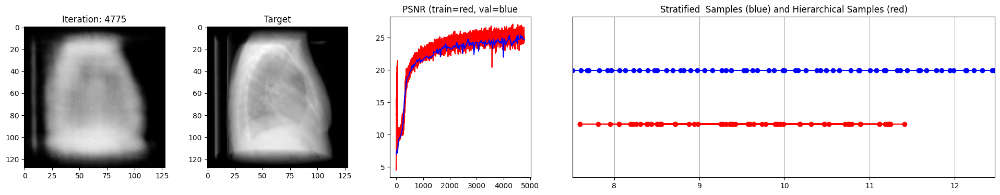

 48%|████▊     | 4800/10000 [29:30<31:50,  2.72it/s]

Loss: 0.0030542146414518356
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


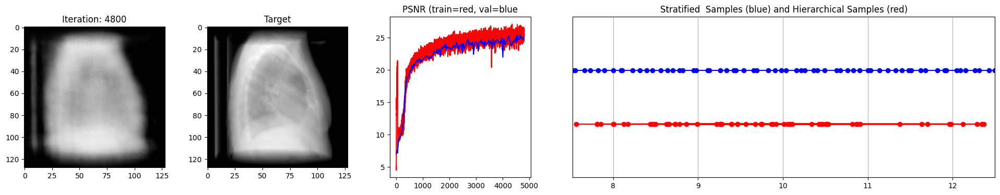

 48%|████▊     | 4825/10000 [29:40<31:41,  2.72it/s]

Loss: 0.0029165134765207767
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


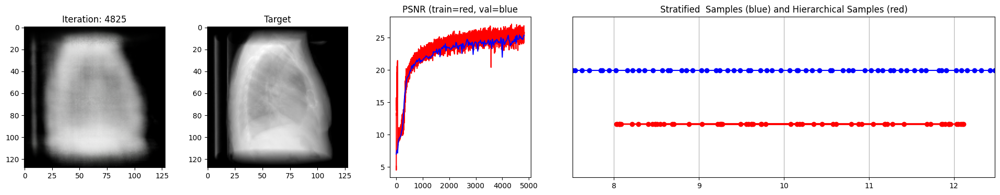

 48%|████▊     | 4850/10000 [29:49<31:28,  2.73it/s]

Loss: 0.002934569027274847
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


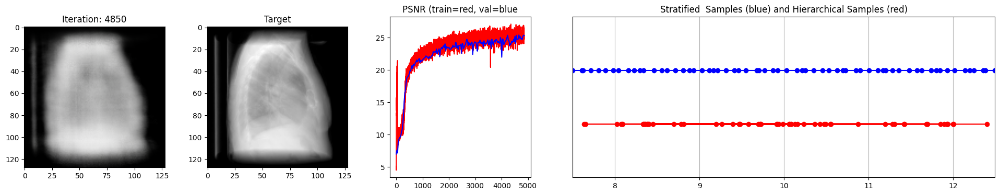

 52%|█████▏    | 5150/10000 [31:44<29:17,  2.76it/s]

Loss: 0.004022953100502491
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


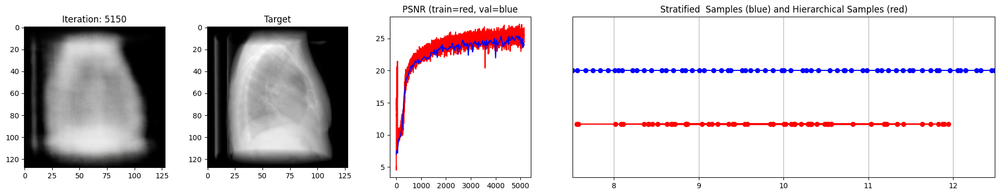

 52%|█████▏    | 5175/10000 [31:54<29:17,  2.75it/s]

Loss: 0.0032492540776729584
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


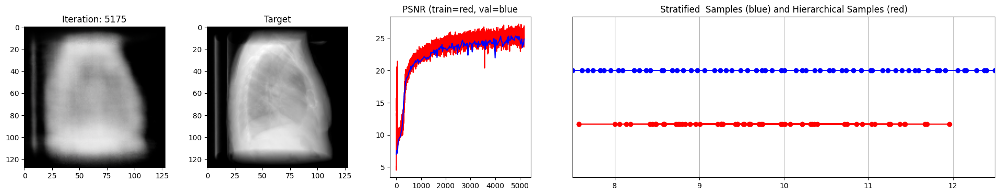

 52%|█████▏    | 5200/10000 [32:03<29:10,  2.74it/s]

Loss: 0.0029078114312142134
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


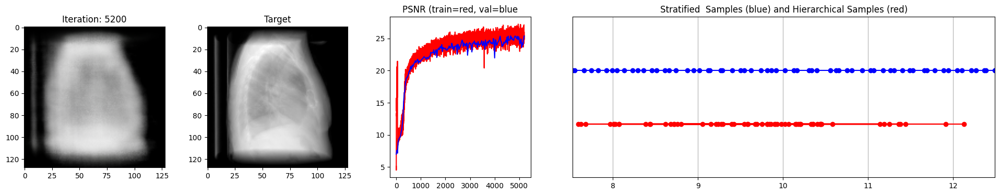

 52%|█████▏    | 5225/10000 [32:13<28:54,  2.75it/s]

Loss: 0.003271434223279357
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


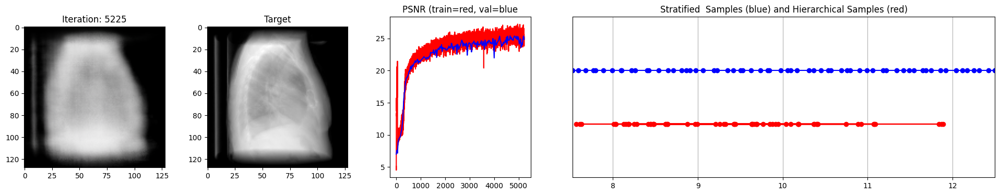

 52%|█████▎    | 5250/10000 [32:22<28:52,  2.74it/s]

Loss: 0.0033571450039744377
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


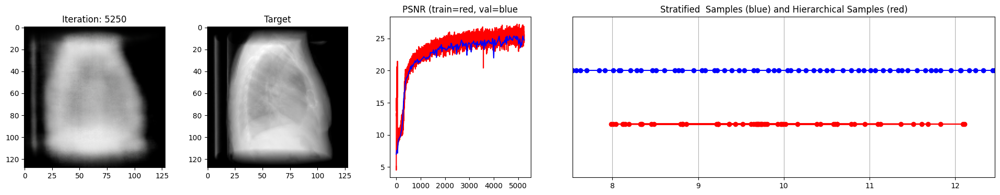

 53%|█████▎    | 5275/10000 [32:31<28:38,  2.75it/s]

Loss: 0.0034101372584700584
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


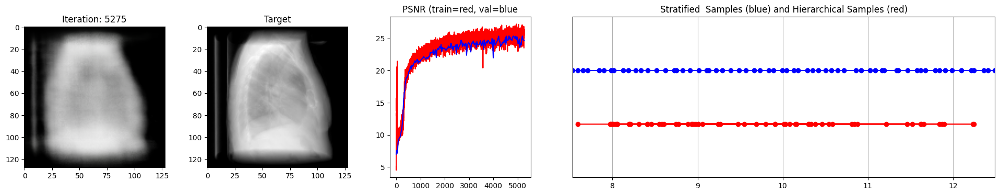

 53%|█████▎    | 5300/10000 [32:41<28:42,  2.73it/s]

Loss: 0.003303663805127144
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


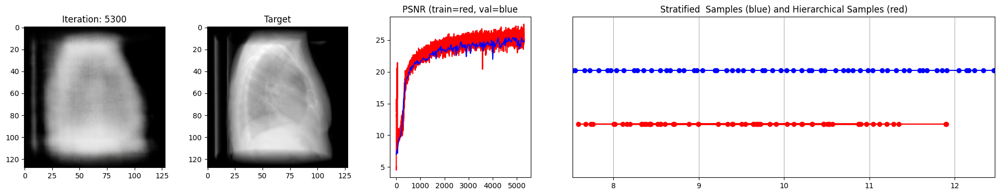

 53%|█████▎    | 5325/10000 [32:50<28:18,  2.75it/s]

Loss: 0.0033722114749252796
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


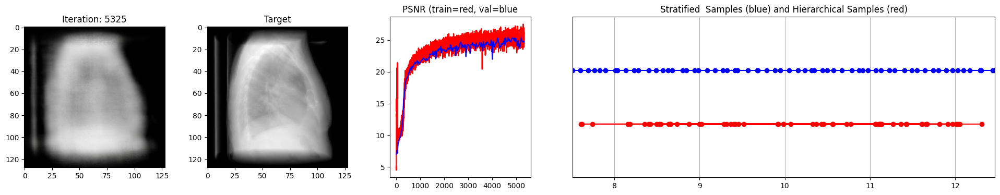

 54%|█████▎    | 5350/10000 [33:00<28:14,  2.74it/s]

Loss: 0.00385833065956831
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


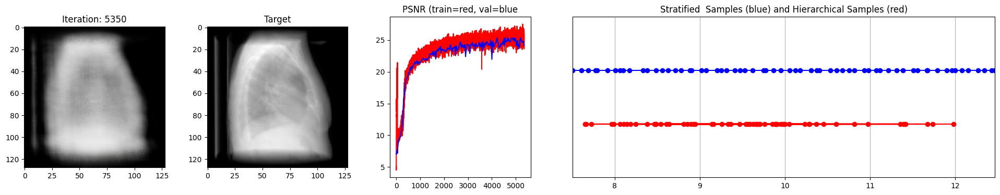

 54%|█████▍    | 5375/10000 [33:09<27:57,  2.76it/s]

Loss: 0.003910900093615055
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


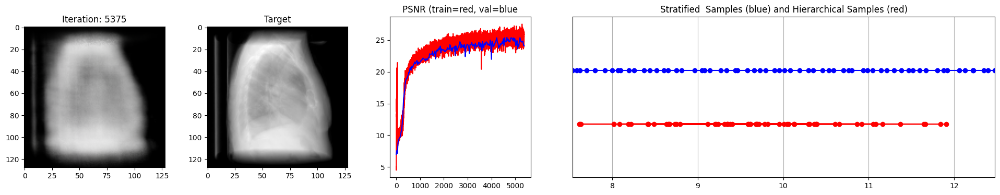

 54%|█████▍    | 5400/10000 [33:18<27:51,  2.75it/s]

Loss: 0.003567927982658148
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


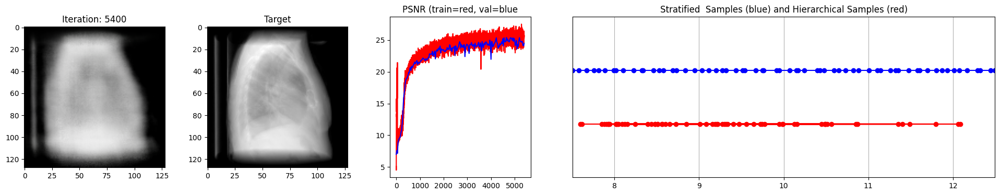

 54%|█████▍    | 5425/10000 [33:27<27:47,  2.74it/s]

Loss: 0.002997498493641615
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


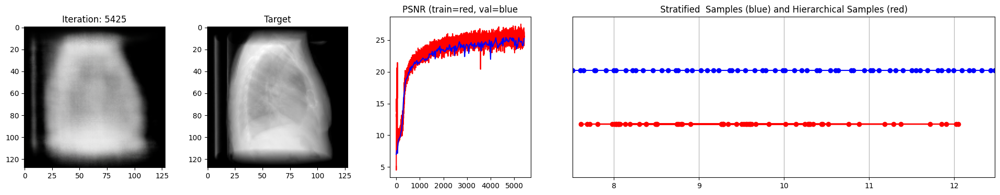

 55%|█████▍    | 5450/10000 [33:37<25:44,  2.95it/s]

Loss: 0.0030532083474099636
tensor([[10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        ...,
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726],
        [10.2121, -0.8934,  2.2726]], device='cuda:0') tensor([[-9.9907e-01, -4.1555e-04, -1.3102e-01],
        [-9.9895e-01,  9.4625e-04, -1.3102e-01],
        [-9.9883e-01,  2.3081e-03, -1.3102e-01],
        ...,
        [-9.4674e-01,  1.6654e-01, -3.0052e-01],
        [-9.4662e-01,  1.6790e-01, -3.0052e-01],
        [-9.4651e-01,  1.6926e-01, -3.0052e-01]], device='cuda:0')


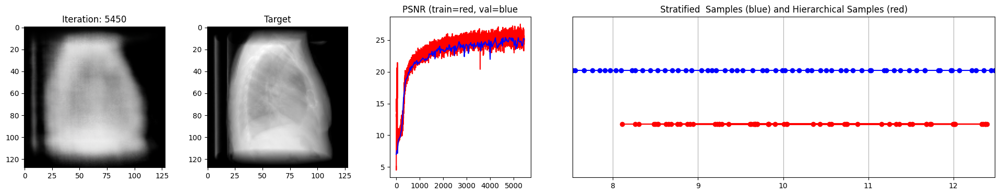

 55%|█████▍    | 5453/10000 [33:38<29:49,  2.54it/s]

In [ ]:
# Run training session(s)
for _ in range(n_restarts):
  model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper = init_models()
  success, train_psnrs, val_psnrs = train()
  if success and val_psnrs[-1] >= warmup_min_fitness:
    print('Training successful!')
    break

print('')
print(f'Done!')